# 前モデルの説明: `CircleModel2`
- サークルグラフを考える。
- 各世代ごとにノードiのリソースが最大となり、ノード mod(i + N/2, N) のリソースが最小となる。
- 各ノードは隣接ノードの一つとゲームを行う。
    - C: 自分のリソースのrを拠出し、プール財をb倍して均等配分。
    - D: 自分はリソースを拠出せず、プール財をb倍して均等配分。
- Death & Birth
    - Param.resource_limit 以下のリソースしか持っていないエージェントは全員死ぬ。
    - 死んだ人数分、親が選ばれる。
    - 各親はそれぞれ一人の子を生む。
    - 子は親とつながる。
    - 総エッジ数 < N * \<k\> ÷ 2の場合は、不足分を子から親以外のノードにつなぐ.

→

リッチスポットが動かない場合は、協力率が安定する。つまり、初期協力率からあまり変動しない。

リッチスポットが動く場合は、協力率が不安定になる。100%を実現することもあれば、0%になることもある。

# 当モデルの説明: `CircleModel3`

一度成立した協力レジームが維持されやすくするにはどうすればよいか？を考える。

協力者同士の繋がりを強くして、協力者と非協力者の繋がりを弱める。

`CircleModel2` に以下の変更を加える。

- ネットワークを重み付きネットワークにする。初期重みw0 = 1.0、重みw: 0 < w <= 1
- Interaction
    - Interactionの相手は隣人の内、重みが大きい相手と起こりやすい
    - CCの場合は1.1倍
    - CD, DC, DD の場合は0.9倍
    - 重みは常に 0 < w <= 1 になるように線形変換。
- Death & Birth
    - 親子の繋がりはw0とする。

# Model

In [3]:
using Dates
using StatsBase: mean, std, shuffle, sample, Weights, countmap
using Statistics
using Parameters
using Random: MersenneTwister

using Graphs

using Colors
using Plots
using GraphPlot

using Test: @testset, @test

println("Julia $(VERSION)")
println("Thread count: $(Threads.nthreads())")

Julia 1.10.2
Thread count: 12


In [4]:
# Color scheme
const DARK_BLUE = colorant"#2D579A"
const LIGHT_BLUE = colorant"#9BADCB"
const DARK_RED = colorant"#B32034"
const LIGHT_RED = colorant"#DBBEC1"
const GRAY = colorant"#E3E3E3"
const COLOR_GRAD = cgrad([DARK_RED, GRAY, DARK_BLUE], [0.0, 0.5, 1.0])

[DARK_RED, LIGHT_RED, GRAY, LIGHT_BLUE, DARK_BLUE] |> display
COLOR_GRAD |> display

## Network

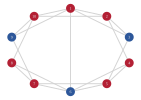

Test Summary:               | Pass  Total  Time
create_weighted_cycle_graph |    9      9  2.8s
Average Degree (k̄):	 3.8
Average Distance (L):	 1.6666666666666667
Average Clustering Coefficient (C):	 0.32142857142857145


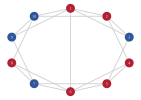

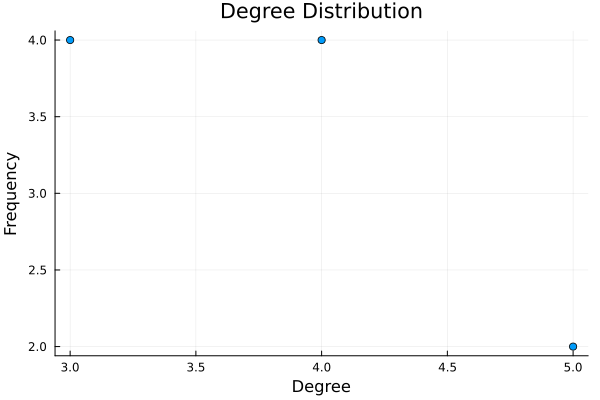

In [6]:
average_degree(g::SimpleGraph)::Float64 = 2 * ne(g) / nv(g)

function average_distance(g::SimpleGraph)::Float64
    n = nv(g)
    shortest_paths = floyd_warshall_shortest_paths(g).dists
    shortest_paths = [path for path in shortest_paths if 0 < path < n]
    total_distance = sum(shortest_paths)
    combinations = length(shortest_paths)
    
    return total_distance / combinations
end

function desc(g::SimpleGraph)::Nothing
    println("Average Degree (k̄):\t $(average_degree(g))")
    println("Average Distance (L):\t $(average_distance(g))")
    println("Average Clustering Coefficient (C):\t $(global_clustering_coefficient(g))")
end

function create_weighted_cycle_graph(N::Int, k::Int, w₀::Float64)::Matrix{Float64}
    @assert N > k > 1 && N % 2 == 0 && k % 2 == 0

    adjacency_matrix = zeros(Float16, N, N)

    for y = 1:N
        for offset = 1:(k ÷ 2)
            x = mod(y + offset - 1, N) + 1
            adjacency_matrix[y, x] = w₀

            x = mod(y - offset - 1, N) + 1
            adjacency_matrix[y, x] = w₀
        end
    end

    return adjacency_matrix
end

create_cycle_graph(N::Int, k::Int)::SimpleGraph = SimpleGraph(create_weighted_cycle_graph(N, k, 1.0))

degree_distribution(g::SimpleGraph)::Dict{Int, Int} = countmap(degree(g))

function plot_graph(g::SimpleGraph, nodefillc::Vector; circle::Bool = true)::Nothing
    if circle
        n = nv(g)
        θ = 2 * π / n  # 各ノードの間の角度
        x_coords = [cos(i * θ - π/2) for i in 0:n-1]
        y_coords = [sin(i * θ - π/2) for i in 0:n-1]

        # layout関数を定義してノードの座標を渡す
        layout = (g -> (x_coords, y_coords))

        gplot(g, nodelabel=1:n, layout=layout, nodelabelc=GRAY, nodefillc=nodefillc) |> display
    else
        gplot(g, nodelabel=1:n, nodelabelc=GRAY, nodefillc=nodefillc) |> display
    end

    return
end

function plot_graph(mat::Matrix{Float64}, nodefillc::Vector)::Nothing
    plot_graph(SimpleGraph(mat), nodefillc)
end

function plot_degree_distribution(g::SimpleGraph)::Nothing
    degree_count = sort(degree_distribution(g))
    xs = collect(keys(degree_count))
    ys = [degree_count[x] for x in xs]
    p1 = plot(xs, ys, seriestype=:scatter, legend=false,
        xlabel="Degree", ylabel="Frequency", 
        title="Degree Distribution")

    # # 対数スケールのプロット
    # p2 = plot(xs, ys, seriestype=:scatter, legend=false, xscale=:log10, yscale=:log10, 
    #     xlabel="Degree (log scale)", ylabel="Frequency (log scale)", 
    #     title="Degree Distribution (Log-Log Scale)")

    display(p1)
    # plot(p1, p2, layout=(1, 2), size=(1000, 400)) |> display
end

mat_nv(mat::Matrix{Float64})::Int = size(mat, 1)

mat_ne(mat::Matrix{Float64})::Int = Int(sum(mat .> 0.0) / 2)

mat_degree(mat::Matrix{Float64})::Vector{Int} = vec(sum(mat .> 0, dims=2))

function mat_update_weight!(mat::Matrix{Float64}, x::Int, y::Int, w::Float64)::Nothing
    mat[x, y] = mat[y, x] = w
    return
end

mat_non_neighbors(mat::Matrix{Float64}, x::Int)::Vector{Int} = filter(!=(x), findall(==(0.0), mat[x, :]))

@testset "create_weighted_cycle_graph" begin
    mat = create_weighted_cycle_graph(10, 4, 0.5)
    @test mat_nv(mat) == 10
    @test mat_ne(mat) == 20
    @test mat_degree(mat) == fill(4, 10)
    
    mat_update_weight!(mat, 1, 6, 0.1)
    @test mat_nv(mat) == 10
    @test mat_ne(mat) == 21
    @test mat_degree(mat) == [5, 4, 4, 4, 4, 5, 4, 4, 4, 4]

    mat_update_weight!(mat, 3, 4, 0.0)
    mat_update_weight!(mat, 8, 9, 0.0)
    @test mat_nv(mat) == 10
    @test mat_ne(mat) == 19
    @test mat_degree(mat) == [5, 4, 3, 3, 4, 5, 4, 3, 3, 4]
    
    plot_graph(mat, rand([DARK_RED, DARK_BLUE], 10))
end

N = 10
g = create_cycle_graph(N, 4)
add_edge!(g, 1, 6)
rem_edge!(g, 3, 4)
rem_edge!(g, 8, 9)
desc(g)

plot_graph(g, rand([DARK_RED, DARK_BLUE], 10))
plot_degree_distribution(g)

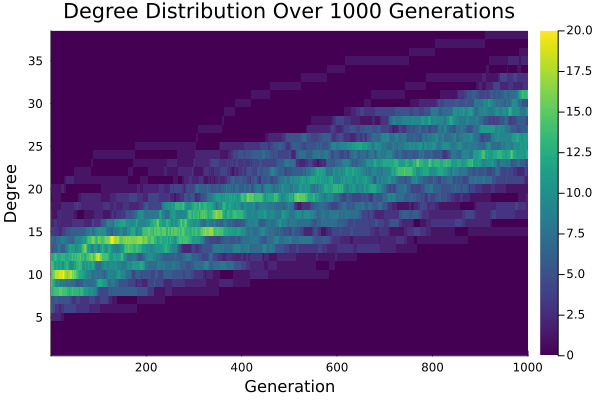

In [7]:
# エルデシュ・レーニ・グラフの初期化
n = 100  # ノード数
p = 0.1  # エッジの確率
initial_graph = erdos_renyi(n, p)

# 1000世代分の次数分布のデータを収集
generations = 1000
degree_distributions = []

for gen in 1:generations
    # ここでネットワークの進化をシミュレートする（例：新しいエッジの追加）
    add_edge!(initial_graph, rand(1:n), rand(1:n))

    # 現在のグラフの次数分布を計算
    dist = degree_distribution(initial_graph)
    push!(degree_distributions, dist)
end

# 各世代ごとの最大次数を取得
max_degree = maximum([maximum(keys(dist)) for dist in degree_distributions])

# ヒートマップのデータを準備
heatmap_data = zeros(Int, max_degree+1, generations)
for gen in 1:generations
    for (degree, count) in degree_distributions[gen]
        heatmap_data[degree+1, gen] = count
    end
end

# ヒートマップをプロット
heatmap(heatmap_data, xlabel="Generation", ylabel="Degree", title="Degree Distribution Over 1000 Generations", color=:viridis)

## Model structure

In [9]:
@enum Strategy C D

strategies_to_colors(strategy_vec::Vector{Strategy})::Vector{RGB} = [s == C ? DARK_BLUE : DARK_RED for s in strategy_vec]

mutate(strategy::Strategy)::Strategy = (strategy == C ? D : C)

@with_kw mutable struct Param
    N::Int = 100               # population
    k₀::Int = 2                # initial degree
    w₀::Float64 = 0.5          # initial weight
    C_rate₀::Float64 = 0.5     # initial cooperator(C)'s freqtrialscy
    b::Float64 = 1.25          # benefit to defect
    relationship_increment_factor::Float64 = 1.1
    resource_decrement_factor::Float64 = 0.9
    resource_limit::Float64 = 0.5
    ev_hop::Int = -1           # rich spot の移動幅 (場所)
    ev_interval::Int = 1       # rich spot の移動間隔 (時間)
    δ::Float64 = 0.99          # selection pressure
    μ::Float64 = 0.01          # mutation rate
    generations::Int = 2_000   # time steps
    trials::Int = 10           # trial count
    rng::MersenneTwister = MersenneTwister() # random generator
end

function to_string(p::Param)::String
    fields = [getfield(p, f) for f in fieldnames(Param) if f != :rng]
    return join(fields, ",")
end

mutable struct Model
    # model's parameters
    p::Param
    rich_spot::Int # spot which has richest resource

    # agent's parameters
    strategy_vec::Vector{Strategy}  # agents' strategy
    resource_vec::Vector{Float64}   # agents' resource
    relation_mat::Matrix{Float64}

    function Model(p::Param)
        C_count = round(Int, p.N * p.C_rate₀)
        strategy_vec = shuffle(p.rng, vcat(fill(C, C_count), fill(D, p.N - C_count)))

        resource_vec = fill(0.0, p.N)

        relation_mat = create_weighted_cycle_graph(p.N, p.k₀, p.w₀)

        return new(p, 1, strategy_vec, resource_vec, relation_mat)
    end
end

C_rate(m::Model)::Float64 = mean([s == C for s in m.strategy_vec])

average_resource(m::Model)::Float64 = mean(m.resource_vec)

@testset "Param & Model" begin
    m = Model(Param())
    @test m.p.N == mat_nv(m.relation_mat) == length(m.strategy_vec) == length(m.resource_vec) == 100
    @test C_rate(m) == 0.5
    @test m.resource_vec == fill(0.0, m.p.N)
    @test mean(mat_degree(m.relation_mat)) == 2.0

    m = Model(Param(N = 10, k₀ = 4, C_rate₀ = 0.2))
    @test m.p.N == mat_nv(m.relation_mat) == length(m.strategy_vec) == length(m.resource_vec) == 10
    @test C_rate(m) == 0.2
    @test m.resource_vec == fill(0.0, m.p.N)
    @test mean(mat_degree(m.relation_mat)) == 4.0
    
    @test to_string(Param()) == "100,2,0.5,0.5,1.25,1.1,0.9,0.5,-1,1,0.99,0.01,2000,10"
end;

Test Summary: | Pass  Total  Time
Param & Model |    9      9  0.2s


## Resource allocation

In [11]:
function resource_allocation!(m::Model)::Nothing
    if m.p.ev_hop < 0
        m.rich_spot = rand(m.p.rng, 1:m.p.N)
    elseif m.p.ev_hop == 0
        # rich_spot is not moved
    else
        m.rich_spot = mod(m.rich_spot + rand(m.p.rng, -m.p.ev_hop:m.p.ev_hop) - 1, m.p.N) + 1
    end
    
    distance_vec = [abs(i - m.rich_spot) for i in 1:m.p.N]
    distance_vec = [distance > m.p.N ÷ 2 ? m.p.N - distance : distance for distance in distance_vec]
    m.resource_vec = [m.p.resource_decrement_factor^distance for distance in distance_vec]

    return
end

@testset "resource_allocation!" begin
    @testset "ev_hop = -1" begin
        m = Model(Param(N = 10, k₀ = 4, resource_decrement_factor = 0.5, rng = MersenneTwister(1)))
        resource_allocation!(m)
        @test m.rich_spot == 6
        @test m.resource_vec == [1/2^5, 1/2^4, 1/2^3, 1/2^2, 1/2, 1, 1/2, 1/2^2, 1/2^3, 1/2^4]

        m = Model(Param(N = 10, k₀ = 4, resource_decrement_factor = 0.5, rng = MersenneTwister(2)))
        resource_allocation!(m)
        @test m.rich_spot == 1
        @test m.resource_vec == [1, 1/2, 1/2^2, 1/2^3, 1/2^4, 1/2^5, 1/2^4, 1/2^3, 1/2^2, 1/2]
    end

    @testset "ev_hop = 1" begin
        m = Model(Param(N = 10, k₀ = 4, ev_hop  = 1, resource_decrement_factor = 0.5, rng = MersenneTwister(1)))
        prior_position = m.rich_spot
        hop_vec = []
        for _ in 1:100
            resource_allocation!(m)
            hop = prior_position - m.rich_spot
            hop = hop > 1 ? -1 : hop
            hop = hop < -1 ? 1 : hop
            append!(hop_vec, hop)
            prior_position = m.rich_spot
        end
        @test mean(hop_vec) ≈ 0.0 atol = 0.1
        @test std(hop_vec) ≈ 0.84 atol = 0.1
    end
end;

Test Summary:        | Pass  Total  Time
resource_allocation! |    6      6  0.0s


## Interaction

In [13]:
function contributable_resource(resource::Float64, resource_limit::Float64)::Float64
    # 全リソースを拠出するパターン
    # return resource
    # 余剰リソースを拠出するパターン
    return max(resource - resource_limit, 0)
    # リソースリミットを超えている場合は余剰リソースを拠出し、リソースリミットを下回っている場合は全リソースを拠出するパターン
    # return resource - (resource > resource_limit ? resource_limit : 0)
end

function weighted_interaction!(m::Model)::Vector{Tuple{Int, Int}}
    id_pair_vec = Vector{Tuple{Int, Int}}()

    for focal_id in 1:m.p.N
        # focal と他のエージェントとの関係ベクトル
        relation_vec = m.relation_mat[focal_id, :]
        sum(relation_vec) == 0 && continue

        # opponent を選択 (関係が深いエージェントが選ばれやすい)
        opponent_id = sample(m.p.rng, 1:m.p.N, Weights(relation_vec))
        push!(id_pair_vec, (focal_id, opponent_id))

        # focal と opponent が拠出可能なリソース
        focal_resource, opponent_resource = [contributable_resource(r, m.p.resource_limit) for r in m.resource_vec[[focal_id, opponent_id]]]

        # Pair-wise PGG
        strategy_pair = m.strategy_vec[[focal_id, opponent_id]]
        if strategy_pair == [C, C]
            poor_resource = (focal_resource + opponent_resource) * m.p.b
            m.resource_vec[focal_id] += poor_resource / 2 - focal_resource
            m.resource_vec[opponent_id] += poor_resource / 2 - opponent_resource
        elseif strategy_pair == [C, D]
            poor_resource = focal_resource * m.p.b
            m.resource_vec[focal_id] += poor_resource / 2 - focal_resource
            m.resource_vec[opponent_id] += poor_resource / 2
        elseif strategy_pair == [D, C]
            poor_resource = opponent_resource * m.p.b
            m.resource_vec[focal_id] += poor_resource / 2
            m.resource_vec[opponent_id] += poor_resource / 2 - opponent_resource
        end

        # Update relationship
        if strategy_pair == [C, C]
            m.relation_mat[focal_id, opponent_id] *= m.p.relationship_increment_factor
        else
            m.relation_mat[focal_id, opponent_id] /= m.p.relationship_increment_factor
        end
        m.relation_mat[focal_id, opponent_id] = max(m.relation_mat[focal_id, opponent_id], 1.0)
        m.relation_mat[opponent_id, focal_id] = m.relation_mat[focal_id, opponent_id]
    end
    
    return id_pair_vec
end

@testset "contributable_resource" begin
end

@testset "weighted_interaction!" begin
    @testset "normal" begin
        m = Model(Param(N = 10, k₀ = 4, C_rate₀ = 0.4, resource_decrement_factor = 0.5, resource_limit = 0.1, rng = MersenneTwister(1)))
        resource_allocation!(m)
        @test m.strategy_vec == [D, D, C, D, C, D, D, C, D, C]
        @test m.resource_vec == [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 0.5, 0.25, 0.125, 0.0625]

        pair_id_vec = weighted_interaction!(m)
        @test pair_id_vec == [(1, 3), (2, 10), (3, 1), (4, 2), (5, 4), (6, 4), (7, 6), (8, 10), (9, 1), (10, 8)]
        @test m.resource_vec == [0.056640625, 0.0625, 0.109765625, 0.5, 0.35, 1.0, 0.5, 0.19375, 0.125, 0.19375]

        m = Model(Param(N = 10, k₀ = 4, C_rate₀ = 0.4, resource_decrement_factor = 0.5, resource_limit = 0.0, rng = MersenneTwister(1)))
        resource_allocation!(m)

        id_pair_vec = weighted_interaction!(m)
        @test id_pair_vec == [(1, 3), (2, 10), (3, 1), (4, 2), (5, 4), (6, 4), (7, 6), (8, 10), (9, 1), (10, 8)]
        @test m.resource_vec == [0.158203125, 0.1015625, 0.048828125, 0.5625, 0.3125, 1.0, 0.5, 0.225830078125, 0.125, 0.225830078125]
    end
    
    @testset "solitary node" begin
        m = Model(Param(N = 10, k₀ = 4, C_rate₀ = 0.4, resource_decrement_factor = 0.5, resource_limit = 0.1, rng = MersenneTwister(1)))
        resource_allocation!(m)

        # delete all edges of 3
        mat_update_weight!(m.relation_mat, 3, 1, 0.0)
        mat_update_weight!(m.relation_mat, 3, 2, 0.0)
        mat_update_weight!(m.relation_mat, 3, 4, 0.0)
        mat_update_weight!(m.relation_mat, 3, 5, 0.0)
        # delete all edges of 6 except (6, 5)
        mat_update_weight!(m.relation_mat, 6, 4, 0.0)
        mat_update_weight!(m.relation_mat, 6, 7, 0.0)
        mat_update_weight!(m.relation_mat, 6, 8, 0.0)
        # delete all edges of 10
        mat_update_weight!(m.relation_mat, 10, 1, 0.0)
        mat_update_weight!(m.relation_mat, 10, 2, 0.0)
        mat_update_weight!(m.relation_mat, 10, 8, 0.0)
        mat_update_weight!(m.relation_mat, 10, 9, 0.0)

        id_pair_vec = weighted_interaction!(m)
        @test id_pair_vec == [(1, 2), (2, 4), (4, 2), (5, 4), (6, 5), (7, 5), (8, 7), (9, 8)]
        @test m.resource_vec == [0.03125, 0.0625, 0.125, 0.5, 0.19765624999999998, 1.15625, 0.69140625, 0.15859375, 0.18359375, 0.0625]
    end
end;

Test Summary:          |Time
contributable_resource | None  0.0s
Test Summary:         | Pass  Total  Time
weighted_interaction! |    8      8  0.1s


## Death & Birth

In [15]:
function regularize_resource_vec(resource_vec::Vector{Float64}, positive::Bool)::Weights
    weights = positive ? resource_vec .- minimum(resource_vec) : maximum(resource_vec) .- resource_vec
    weights .+= 0.0001
    weights ./= maximum(weights)

    return Weights(weights)
end

function get_death_parent_id_vec(m::Model, is_static::Bool)::Tuple{Vector{Int}, Vector{Int}}
    death_id_vec = []

    if is_static
        death_count = round(Int, m.p.resource_limit * m.p.N)
        death_weights = regularize_resource_vec(m.resource_vec, false)
        death_id_vec = sort(sample(m.p.rng, 1:m.p.N, death_weights, death_count, replace = false))
    else
        death_id_vec = findall(<(m.p.resource_limit), m.resource_vec)
        death_count = length(death_id_vec)
        if death_count == 0
            return Int[], Int[]
        end
    end

    parent_weights = regularize_resource_vec(m.resource_vec, true)
    parent_id_vec = sort(sample(m.p.rng, 1:m.p.N, parent_weights, death_count, replace = false))

    return death_id_vec, parent_id_vec
end

function weighted_death_birth!(m::Model, is_static::Bool = false)::Tuple{Vector{Int}, Vector{Int}}
    death_id_vec, parent_id_vec = get_death_parent_id_vec(m, is_static)
    death_count = length(death_id_vec)
    if death_count == 0
        return Int[], Int[]
    end

    # Strategy
    parent_strategy_vec = m.strategy_vec[parent_id_vec]
    parent_strategy_vec = [rand(m.p.rng) > m.p.μ ? s : mutate(s) for s in parent_strategy_vec]
    m.strategy_vec[death_id_vec] .= parent_strategy_vec

    # Graph
    ## Delete edges
    m.relation_mat[death_id_vec, :] .= 0.0
    m.relation_mat[:, death_id_vec] .= 0.0

    ## Add edges
    add_count = Int(m.p.N * m.p.k₀ / 2 - mat_ne(m.relation_mat))
    while add_count > 0
        for death_id in death_id_vec
            # death_id の非隣人
            non_neighbor_id_vec = mat_non_neighbors(m.relation_mat, death_id)

            # parent_id の候補から parent_id をランダムに選択
            candidate_id_vec = intersect(non_neighbor_id_vec, parent_id_vec)
            if isempty(candidate_id_vec)
                candidate_id_vec = non_neighbor_id_vec
            end
            parent_id = rand(m.p.rng, candidate_id_vec)

            mat_update_weight!(m.relation_mat, parent_id, death_id, m.p.w₀)

            add_count -= 1
            add_count == 0 && break
        end
    end

    @assert m.p.N * m.p.k₀ / 2 == mat_ne(m.relation_mat)

    return death_id_vec, parent_id_vec
end

@testset "regularize_resource_vec" begin
    @test regularize_resource_vec([0.0, 0.0, 0.0, 0.0, 0.0], true) == [1.0, 1.0, 1.0, 1.0, 1.0]
    @test regularize_resource_vec([1.0, 1.0, 1.0, 1.0, 1.0], true) == [1.0, 1.0, 1.0, 1.0, 1.0]

    @test regularize_resource_vec([0.0, 0.0, 1.0, 0.0, 0.0], true) ≈ [0.0, 0.0, 1.0, 0.0, 0.0] atol = 0.001
    @test regularize_resource_vec([0.0, 0.0, 1.0, 0.0, 0.0], false) ≈ [1.0, 1.0, 0.0, 1.0, 1.0] atol = 0.001
    @test regularize_resource_vec([0.0, 0.0, -1.0, 0.0, 0.0], true) ≈ [1.0, 1.0, 0.0, 1.0, 1.0] atol = 0.001

    @test regularize_resource_vec([0.0, 0.2, 0.4, 0.6, 0.8], true) ≈ [0.0, 0.25, 0.5, 0.75, 1.0] atol = 0.001
    @test regularize_resource_vec([0.0, 0.2, 0.4, 0.6, 0.8], false) ≈ [1.0, 0.75, 0.5, 0.25, 0.0] atol = 0.001
    @test regularize_resource_vec([0.0, -0.2, -0.4, -0.6, -0.8], true) ≈ [1.0, 0.75, 0.5, 0.25, 0.0] atol = 0.001
end

@testset "weighted_death_birth!" begin
    m = Model(Param(N = 10, k₀ = 4, C_rate₀ = 0.4, resource_limit = 0.2, resource_decrement_factor = 0.5, rng = MersenneTwister(1)))
    resource_allocation!(m)
    @test m.rich_spot == 6
    @test mat_degree(m.relation_mat) == fill(4, 10)
    @test m.strategy_vec == [D, D, C, D, C, D, D, C, D, C]

    death_id_vec, parent_id_vec = weighted_death_birth!(m, false)
    @test death_id_vec == [1, 2, 3, 9, 10]
    @test parent_id_vec == [3, 4, 5, 6, 9]
    @test m.strategy_vec == [C, D, C, D, C, D, D, C, D, D]
    @test mat_degree(m.relation_mat) == [3, 3, 5, 5, 5, 7, 3, 2, 5, 2]
    @test mat_ne(m.relation_mat) == 20
end

@testset "weighted_death_birth! (static mode)" begin
    m = Model(Param(N = 10, k₀ = 4, C_rate₀ = 0.4, resource_limit = 0.514, resource_decrement_factor = 0.5, rng = MersenneTwister(1)))
    resource_allocation!(m)
    @test m.rich_spot == 6
    @test mat_degree(m.relation_mat) == fill(4, 10)
    @test m.strategy_vec == [D, D, C, D, C, D, D, C, D, C]

    death_id_vec, parent_id_vec = weighted_death_birth!(m, true)
    @show m.resource_vec
    @test death_id_vec == [3, 4, 5, 7, 9]
    @test parent_id_vec == [4, 5, 6, 7, 8]
    @test m.strategy_vec == [D, D, D, C, D, D, D, C, C, C]
    @test mat_degree(m.relation_mat) == [2, 2, 3, 5, 4, 5, 6, 6, 3, 4]
    @test mat_ne(m.relation_mat) == 20
end;

Test Summary:           | Pass  Total  Time
regularize_resource_vec |    8      8  0.1s
Test Summary:         | Pass  Total  Time
weighted_death_birth! |    8      8  0.3s
m.resource_vec = [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 0.5, 0.25, 0.125, 0.0625]
Test Summary:                       | Pass  Total  Time
weighted_death_birth! (static mode) |    8      8  0.0s


## Run all

In [17]:
function run!(m::Model, is_static::Bool = false)::Tuple{Vector{Float64}, Vector{Float64}, Vector{Float64}, Vector{Int}, Matrix{Strategy}, Matrix{Int}, Vector{Float64}, Vector{Float64}}
    C_rate_vec = fill(0.0, m.p.generations)
    average_resource_vec = fill(0.0, m.p.generations)
    death_count_vec = fill(0, m.p.generations)
    rich_spot_vec = fill(0, m.p.generations)
    strategy_mat = fill(C, m.p.generations, m.p.N)
    degree_mat = fill(0, m.p.generations, m.p.N)
    average_distance_vec = fill(0.0, m.p.generations)
    clustering_coefficient_vec = fill(0.0, m.p.generations)

    for generation in 1:m.p.generations
        if generation % m.p.ev_interval == 0
            resource_allocation!(m)
        end

        weighted_interaction!(m)
        death_id_vec, _ = weighted_death_birth!(m, is_static)

        # Log
        C_rate_vec[generation] = C_rate(m)
        average_resource_vec[generation] = average_resource(m)
        death_count_vec[generation] = length(death_id_vec)
        rich_spot_vec[generation] = m.rich_spot
        strategy_mat[generation, :] .= m.strategy_vec
        degree_mat[generation, :] .= mat_degree(m.relation_mat)
        
        g = SimpleGraph(m.relation_mat)
        average_distance_vec[generation] = average_distance(g)
        clustering_coefficient_vec[generation] = global_clustering_coefficient(g)
    end

    return C_rate_vec, average_resource_vec, death_count_vec, rich_spot_vec, strategy_mat, degree_mat, average_distance_vec, clustering_coefficient_vec
end

function run_trials!(p::Param)::Matrix{Float64}
    C_rate_mat = fill(0.0, p.trials, p.generations)
    
    for trial in 1:p.trials
        p.rng = MersenneTwister(round(Int, time() * 1_000_000)) # 現在時刻(マイクロ秒単位)を乱数シードとして使用
        m = Model(p)

        for generation in 1:p.generations
            if generation % m.p.ev_interval == 0
                resource_allocation!(m)
            end

            weighted_interaction!(m)
            weighted_death_birth!(m)

            C_rate_mat[trial, generation] = C_rate(m)
        end
    end

    return C_rate_mat
end;

# Results

## ToDo

- 選択強度
- 環境変動のインターバル
- resource decrementation は指数関数的ではなく線形的にしたほうが良い
- ev_hop を少数に拡張する。例: ev_hopが1.2の場合は80%の確率で1ホップ動き20%の確率で2ホップ動く。
- Update relationshipUpdate relationship 戦略は、DD以外のときは関係を強化してもよいのでは？CDやDCもある意味見返りが不確定な協力(贈与)とみなせる。

## 概要

In [20]:
# b_vec = [1.0, 1.25, 1.5, 1.75, 2.0]
# relationship_increment_factor_vec = [1.0, 1.1, 1.2]
# resource_decrement_factor_vec = [0.8, 0.9, 0.95]
# C_rate₀_vec = [0.0, 0.5, 1.0]
# ev_hop_vec = [0, 1, 2, 4, 8, 16, 32, -1]

# params = vec([(b, rif, rdf, C_rate₀, ev_hop)
#     for b in b_vec,
#         rif in relationship_increment_factor_vec,
#         rdf in resource_decrement_factor_vec,
#         C_rate₀ in C_rate₀_vec,
#         ev_hop in ev_hop_vec])

# const FILE_NAME = "../output/CircleModel_$(Dates.format(now(), "yyyymmdd_HHMMSS")).csv"
# const FIELD_NAMES = join(fieldnames(Param)[1:(end - 1)], ",") * ",cooperation_rate"
# @show FILE_NAME
# @show FIELD_NAMES

# write(FILE_NAME, "$(FIELD_NAMES)\n")
# lk = Threads.ReentrantLock()

# Threads.@threads for (b, rif, rdf, C_rate₀, ev_hop) in params
#     p = Param(
#         N = 100, k₀ = 4, resource_limit = 0.1, generations = 10_000, trials = 100,
#         b = b,
#         relationship_increment_factor = rif,
#         resource_decrement_factor = rdf,
#         C_rate₀ = C_rate₀,
#         ev_hop = ev_hop,
#     )
#     C_rate_mat = run_trials!(p)
#     result_C_rate = mean(C_rate_mat[:, round(Int, p.generations * 0.5):p.generations])

#     lock(lk) do
#         open(FILE_NAME, "a") do io
#             write(io, "$(to_string(p)),$(result_C_rate)\n")
#             flush(io)
#         end
#     end
# end;

## 詳細

In [22]:
C_rate₀ = 0.0
b = 1.75
relationship_increment_factor = 1.0
resource_decrement_factor = 0.9
resource_limit = 0.1
ev_hop_vec = [0, 1, 16, 32]
is_static = false
random_seed = 2;

ev_hop: 0, resource_decrement_factor: 0.9, resource_limit: 0.1
C_rate: 0.0074945010997800494
average_resource: 0.18902078271060957
Average Degree (k̄):	 4.0
Average Distance (L):	 3.618989898989899
Average Clustering Coefficient (C):	 0.15827338129496402


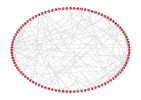

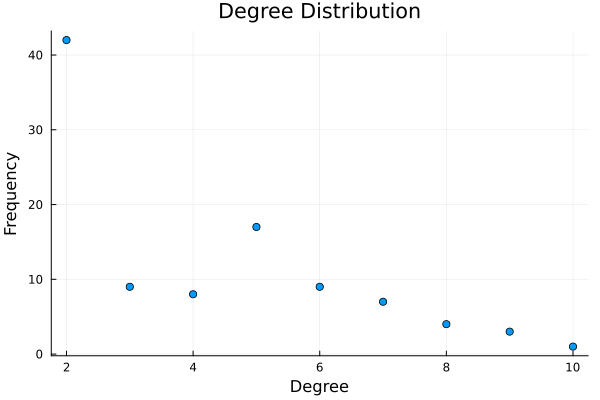

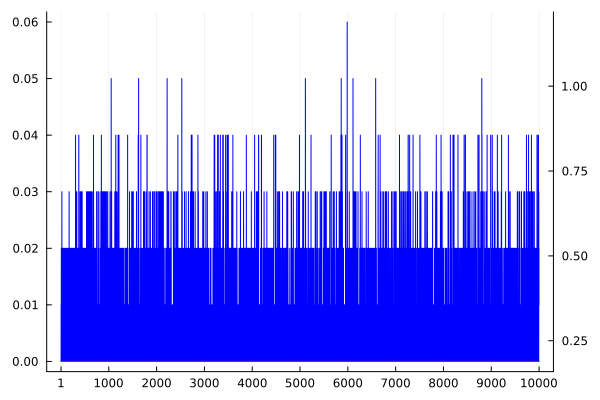

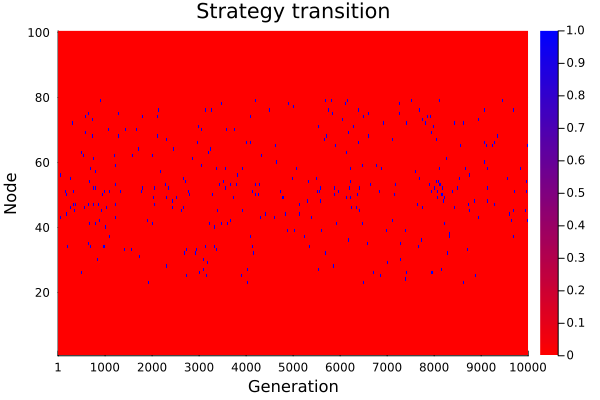

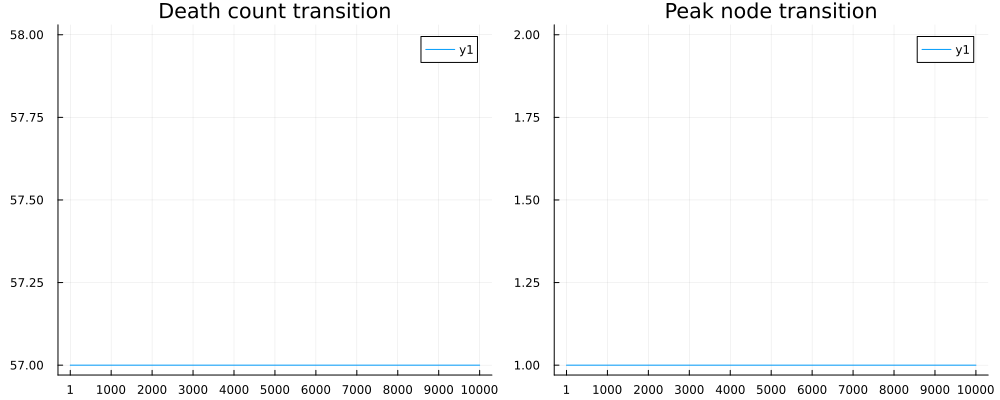

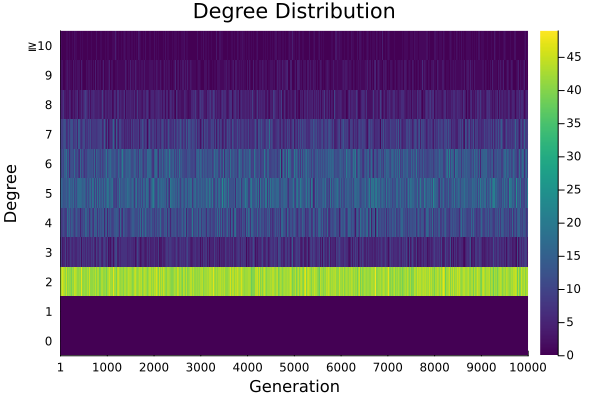

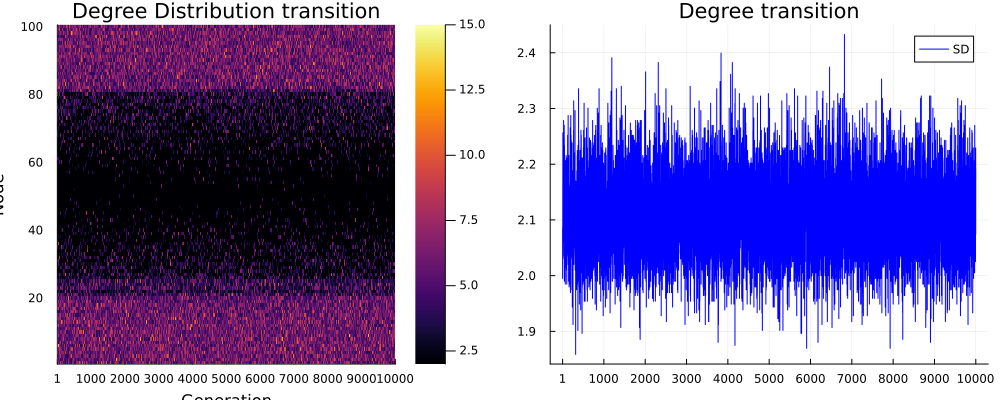

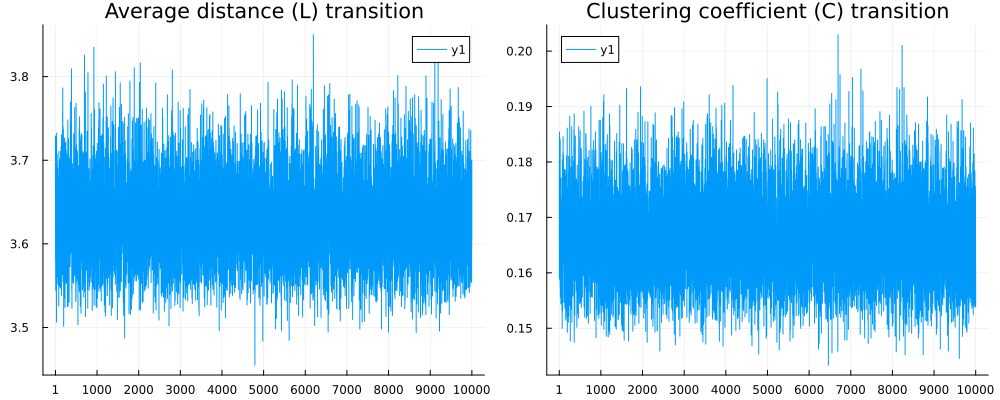

ev_hop: 1, resource_decrement_factor: 0.9, resource_limit: 0.1
C_rate: 0.1650489902019596
average_resource: 0.23756133204556262
Average Degree (k̄):	 4.0
Average Distance (L):	 3.4184704184704184
Average Clustering Coefficient (C):	 0.02920723226703755


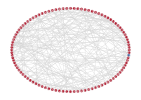

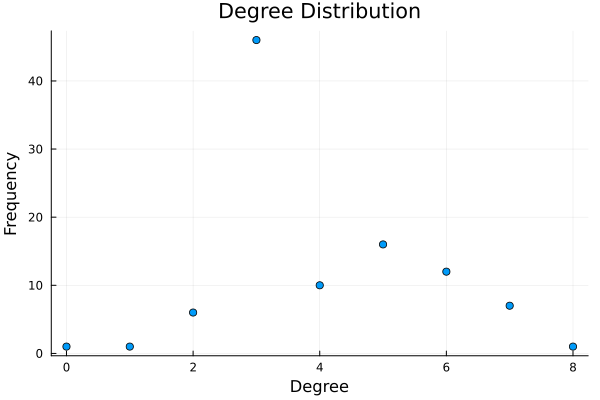

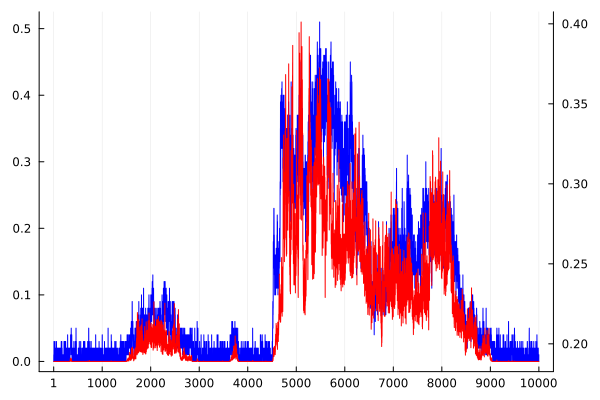

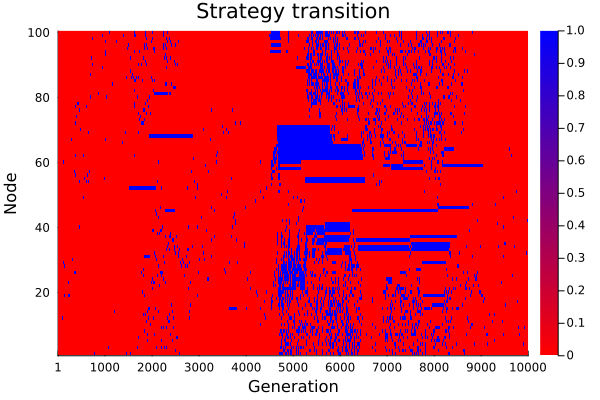

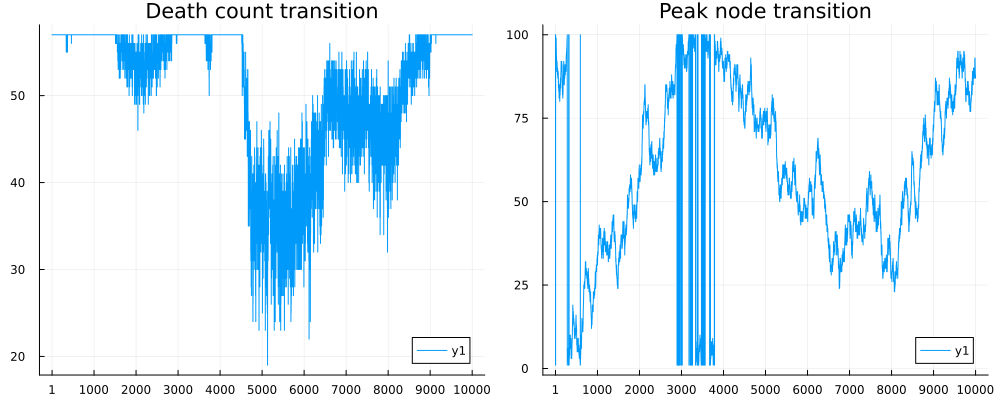

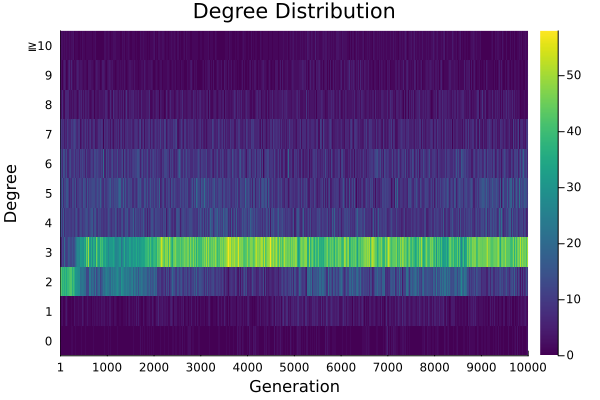

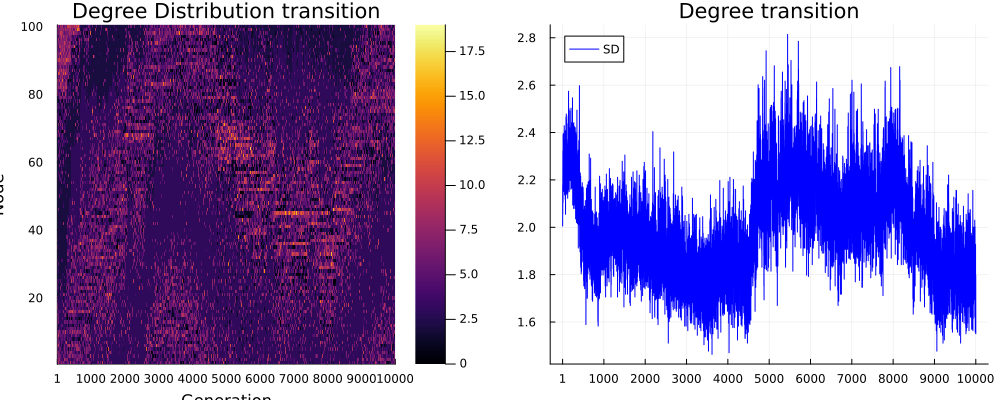

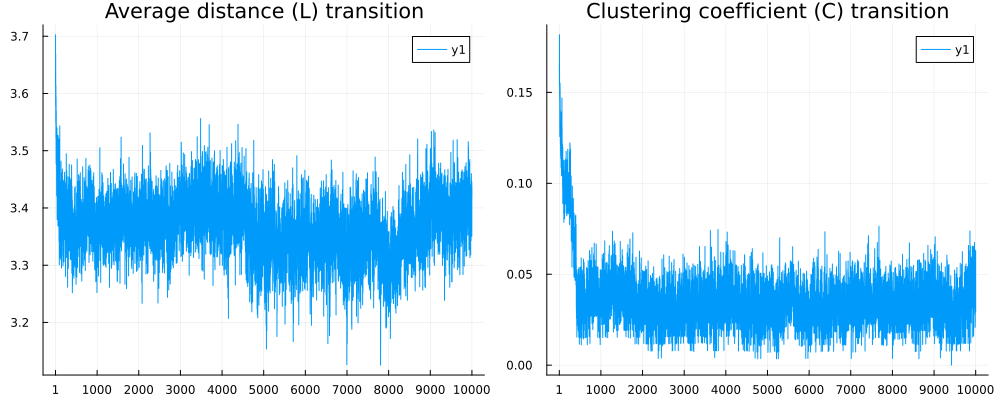

ev_hop: 16, resource_decrement_factor: 0.9, resource_limit: 0.1
C_rate: 0.8117456508698259
average_resource: 0.4604125356634273
Average Degree (k̄):	 4.0
Average Distance (L):	 3.3422222222222224
Average Clustering Coefficient (C):	 0.032806804374240585


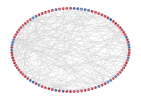

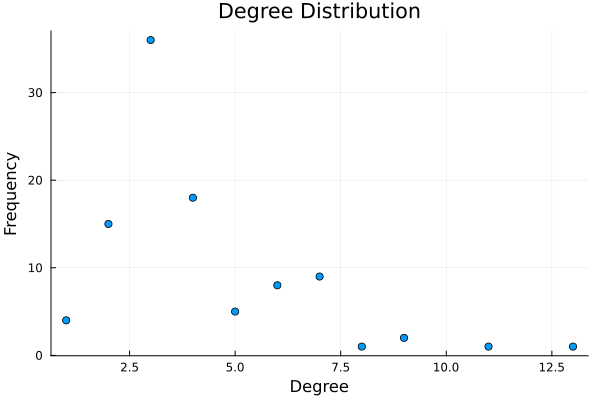

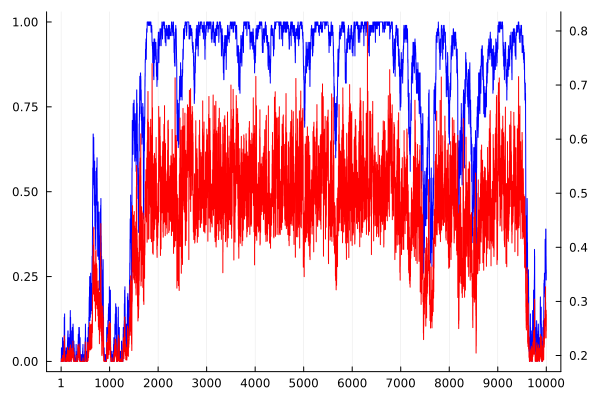

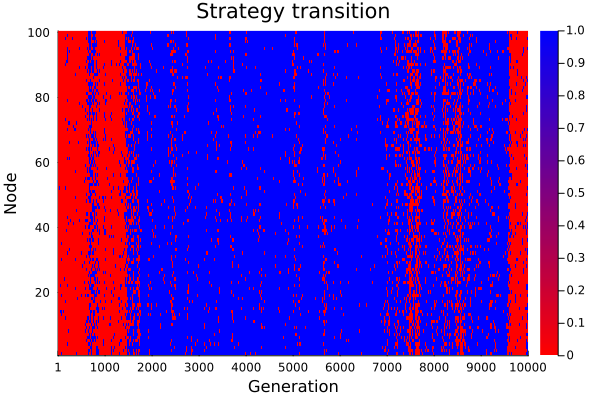

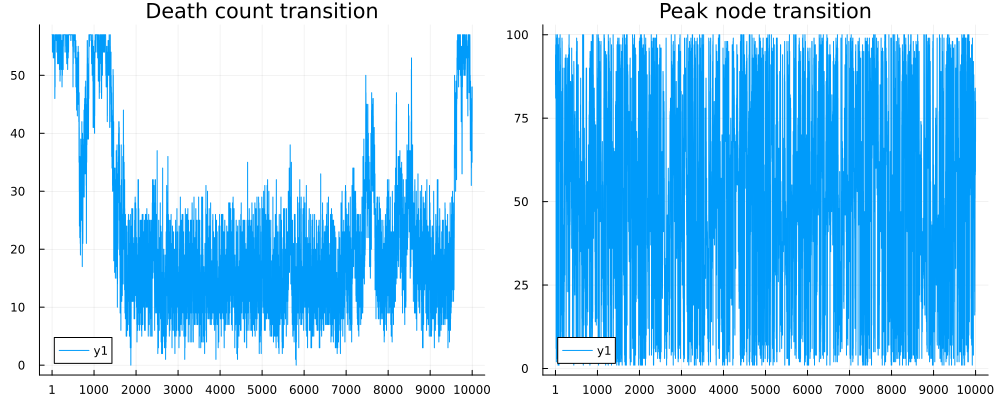

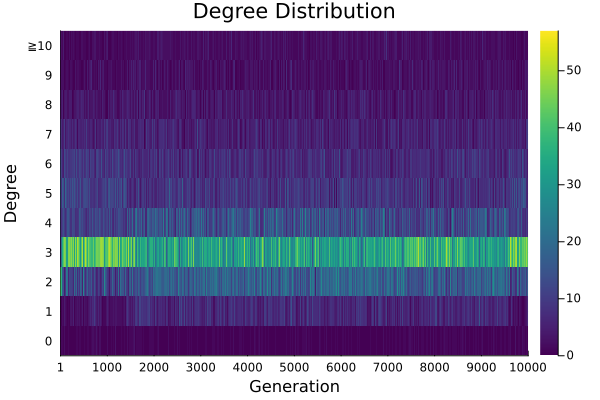

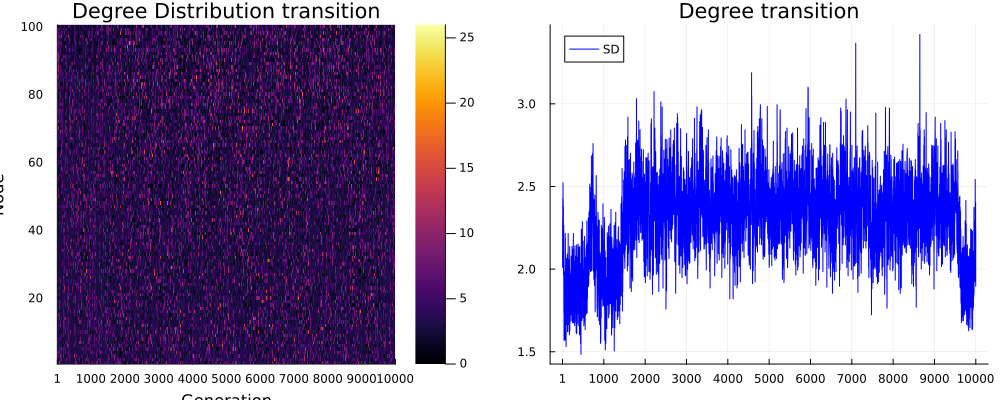

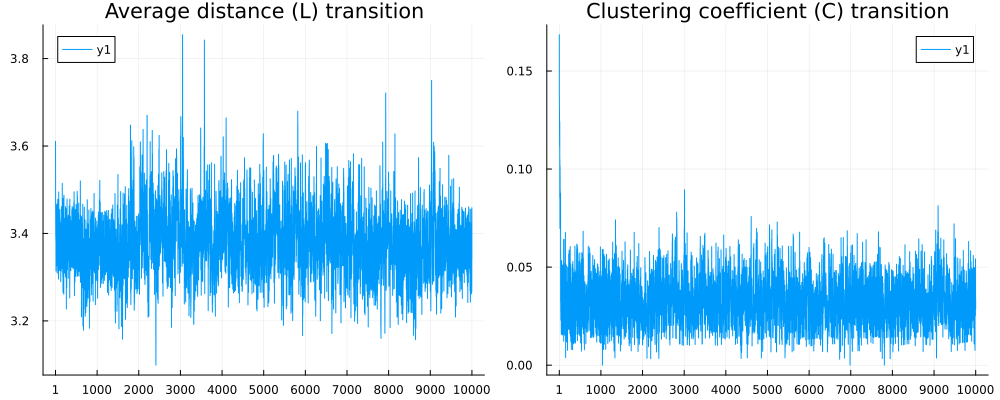

ev_hop: 32, resource_decrement_factor: 0.9, resource_limit: 0.1
C_rate: 0.8159588082383522
average_resource: 0.44451738707673333
Average Degree (k̄):	 4.0
Average Distance (L):	 3.3896969696969697
Average Clustering Coefficient (C):	 0.022483940042826552


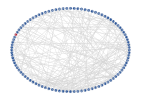

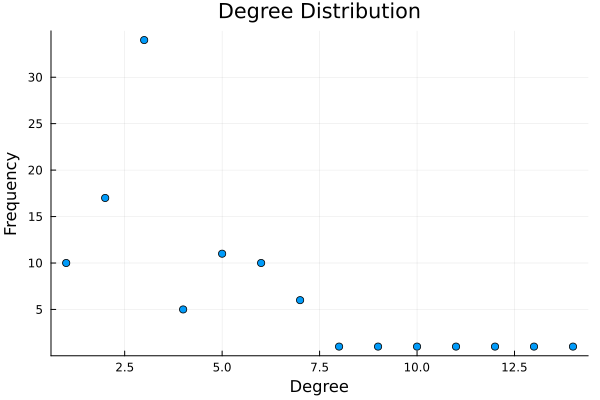

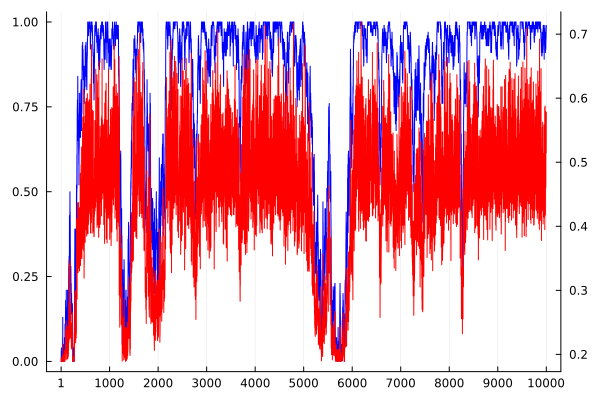

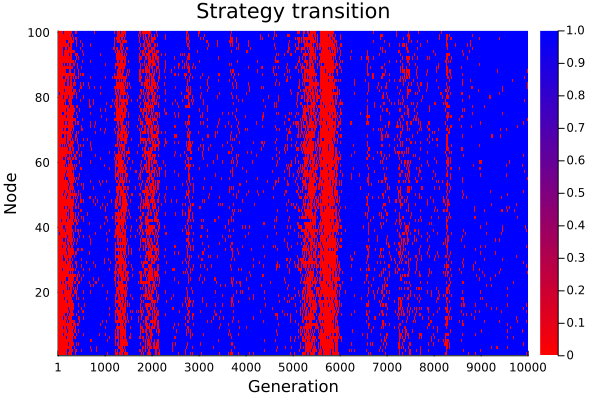

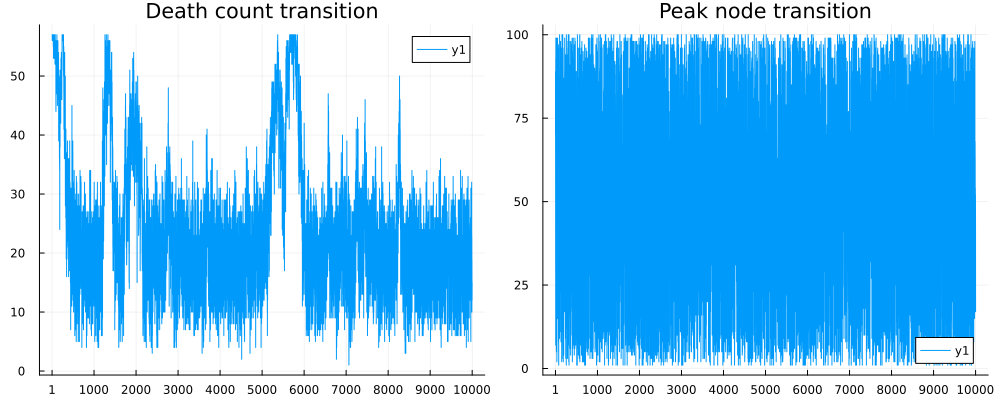

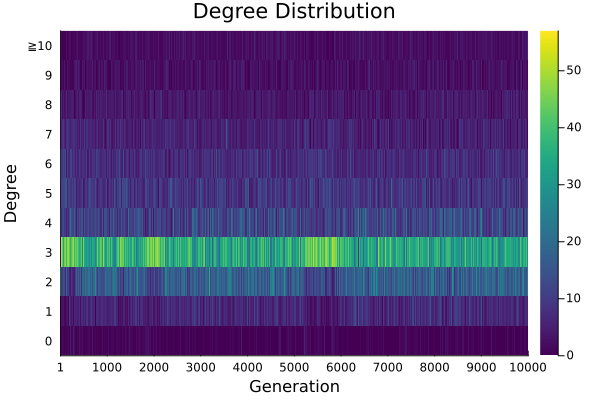

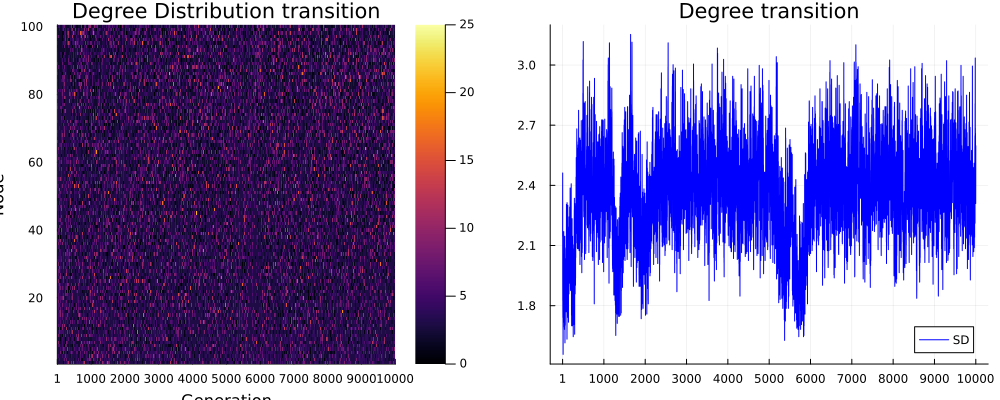

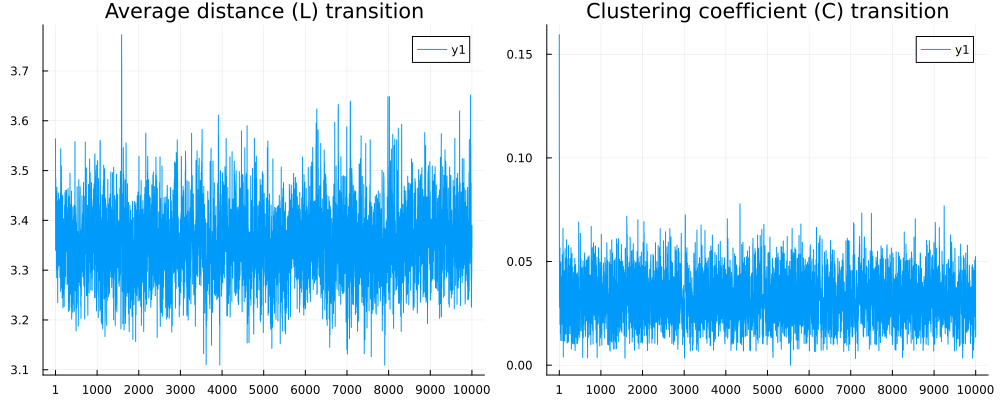

In [23]:
for ev_hop in ev_hop_vec
    p = Param(
        N = 100, k₀ = 4, generations = 10_000,
        b = b,
        C_rate₀ = C_rate₀,
        ev_hop = ev_hop,
        relationship_increment_factor = relationship_increment_factor,
        resource_decrement_factor = resource_decrement_factor,
        resource_limit = resource_limit,
        rng = MersenneTwister(random_seed)
    )
    m = Model(p)
    C_rate_vec, average_resource_vec, death_count_vec, rich_spot_vec, strategy_mat, degree_mat, average_distance_vec, clustering_coefficient_vec = run!(m, is_static)

    println("ev_hop: $(ev_hop), resource_decrement_factor: $(resource_decrement_factor), resource_limit: $(resource_limit)")
    println("C_rate: $(mean(C_rate_vec[round(Int, end * 0.5):end]))")
    println("average_resource: $(mean(average_resource_vec[round(Int, end * 0.5):end]))")
    g = SimpleGraph(m.relation_mat)
    desc(g)
    plot_graph(m.relation_mat, strategies_to_colors(m.strategy_vec))
    plot_degree_distribution(g)
    
    xticks = collect(0:1000:m.p.generations)
    xticks[1] = 1

    p = plot(C_rate_vec, xticks=xticks, label=false, color=:blue)
    plot!(twinx(), average_resource_vec, label=false, color=:red)
    display(p)
    heatmap(transpose(strategy_mat .== C), color=[:red, :blue], xlabel="Generation", xticks=xticks, ylabel="Node", title="Strategy transition") |> display

    p1 = plot(death_count_vec, xticks=xticks, title="Death count transition")
    p2 = plot(rich_spot_vec, xticks=xticks, title="Peak node transition")
    plot(p1, p2, layout=(1, 2), size=(1000, 400)) |> display

    # Degree
    degree_distribution_vec = [countmap(degree_mat[gen, :]) for gen in 1:m.p.generations]
    heatmap_data = zeros(Int, 11, m.p.generations)
    for gen in 1:m.p.generations
        for (degree, count) in degree_distribution_vec[gen]
            if degree > 10
                heatmap_data[11, gen] += count
            else
                heatmap_data[degree + 1, gen] = count
            end
        end
    end
    yticks = string.(collect(0:10))
    yticks[11] = "≧10"
    heatmap(heatmap_data, xlabel="Generation", ylabel="Degree", xticks=xticks, yticks=(1:length(yticks), yticks), title="Degree Distribution", color=:viridis) |> display
    
    p3 = heatmap(transpose(degree_mat), xlabel="Generation", ylabel="Node", xticks=xticks, title="Degree Distribution transition")
    p4 = plot(title="Degree transition", xticks=xticks)
    plot!(std(degree_mat, dims=2), color=:blue, label="SD")
    # plot!(twinx(), maximum(degree_mat, dims=2), color=:red, label="Max")
    plot(p3, p4, layout=(1, 2), size=(1000, 400)) |> display

    # L and C
    plot(
        plot(average_distance_vec, xticks=xticks, title="Average distance (L) transition"),
        plot(clustering_coefficient_vec, xticks=xticks, title="Clustering coefficient (C) transition"),
        layout=(1, 2),
        size=(1000, 400)
    ) |> display
end

## 地理的差異なし

In [25]:
C_rate₀ = 0.5
b_vec = [1.0, 1.25, 1.5, 1.75, 1.9, 1.95, 2.0, 2.05]
relationship_increment_factor = 1.0
resource_decrement_factor = 1.0
resource_limit = 0.1
ev_hop = 1
is_static = true
random_seed = 101;

b: 1.0
C_rate: 0.005528942115768464
average_resource: 1.0
Average Degree (k̄):	 4.0
Average Distance (L):	 3.719966337050284
Average Clustering Coefficient (C):	 0.12661195779601406


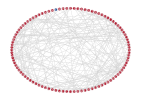

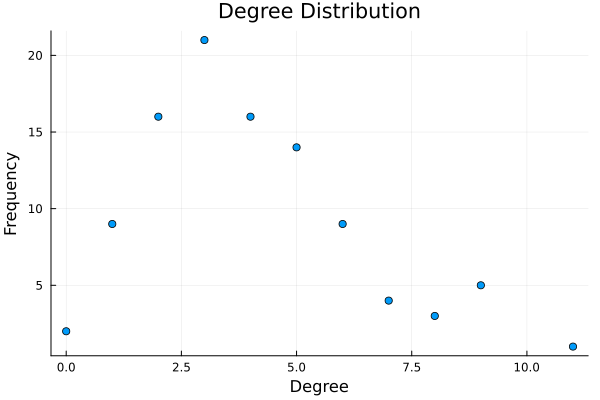

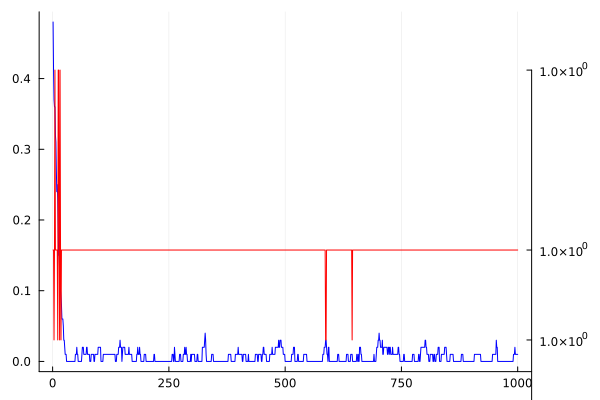

GKS: Possible loss of precision in routine SET_WINDOW


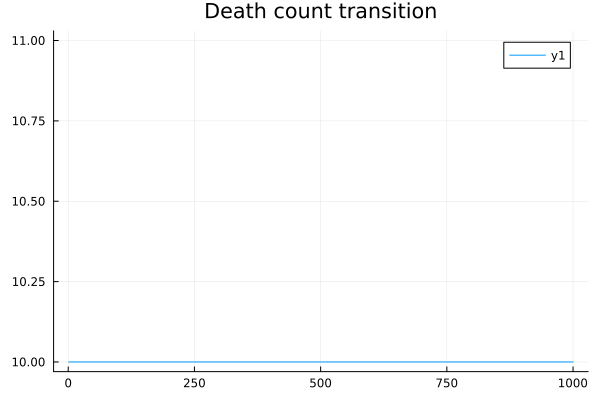

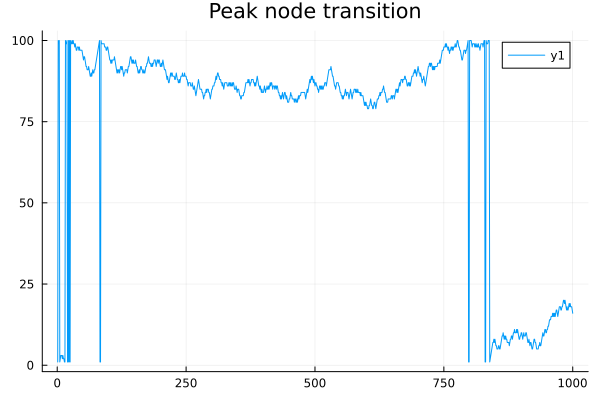

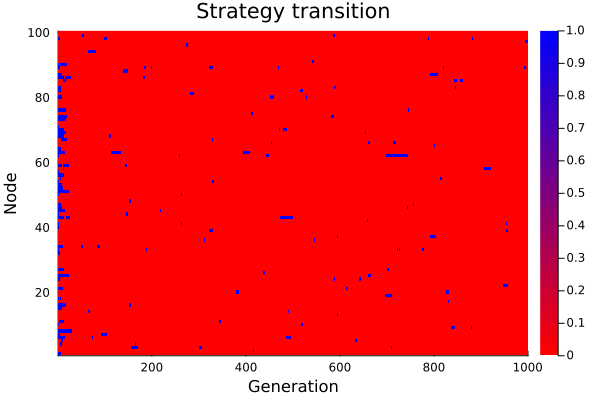

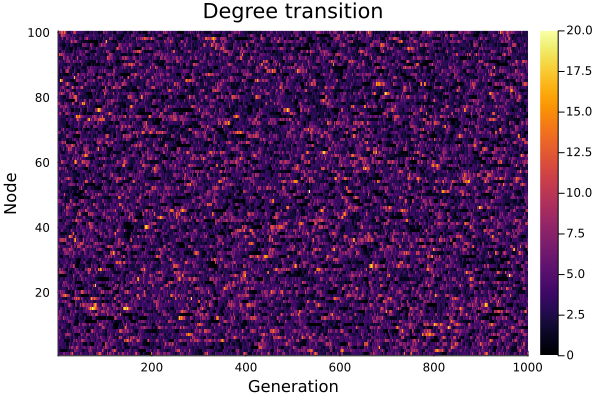

b: 1.25
C_rate: 0.005968063872255491
average_resource: 1.0017422781390348
Average Degree (k̄):	 4.0
Average Distance (L):	 3.523724261414503
Average Clustering Coefficient (C):	 0.06785714285714285


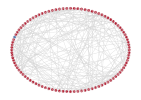

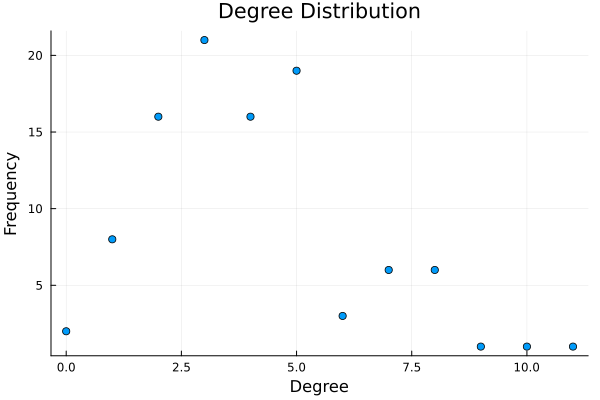

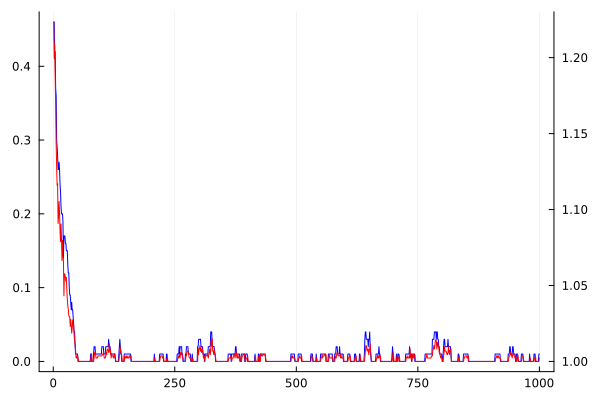

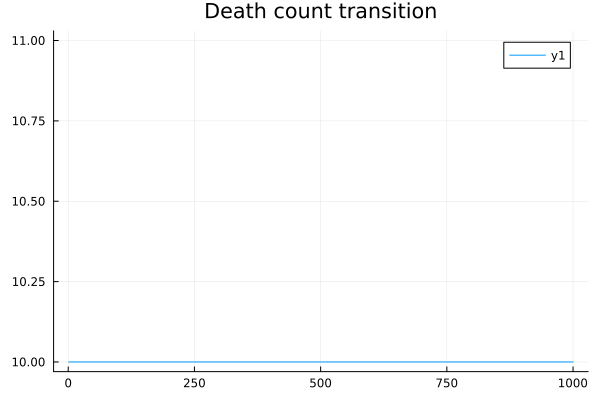

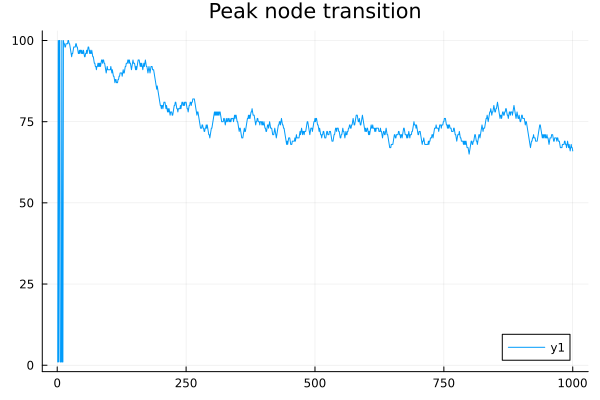

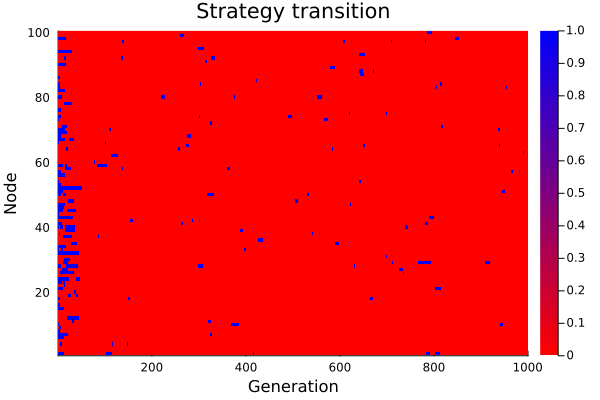

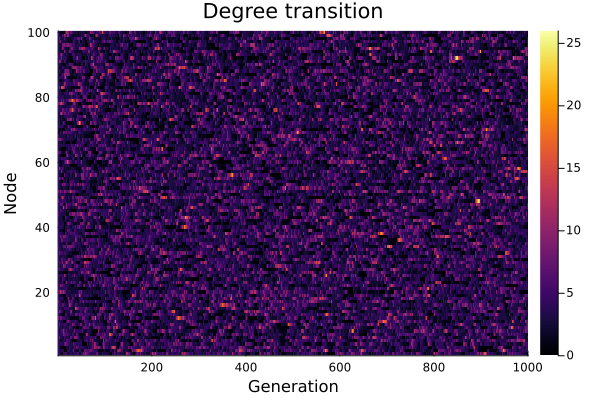

b: 1.5
C_rate: 0.009181636726546911
average_resource: 1.006082855772829
Average Degree (k̄):	 4.0
Average Distance (L):	 3.7168859649122807
Average Clustering Coefficient (C):	 0.10465116279069768


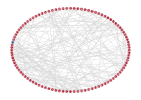

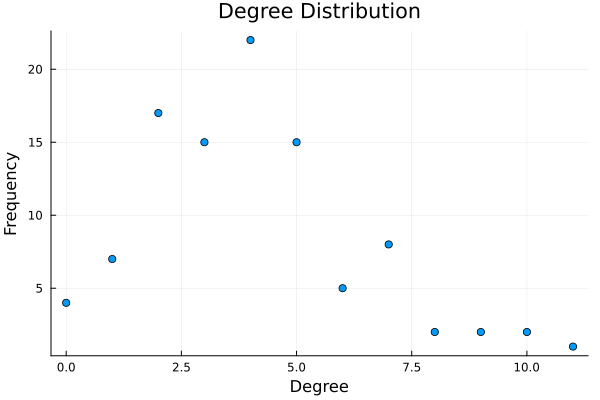

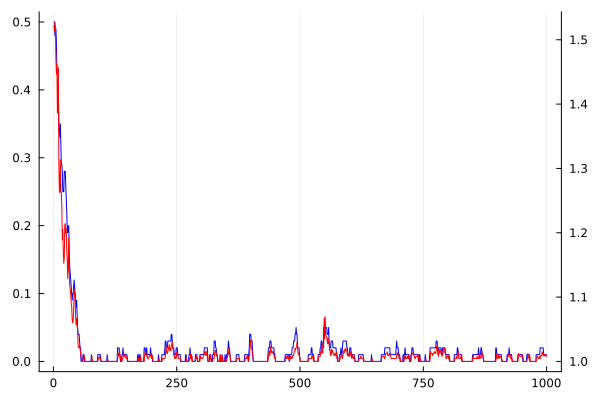

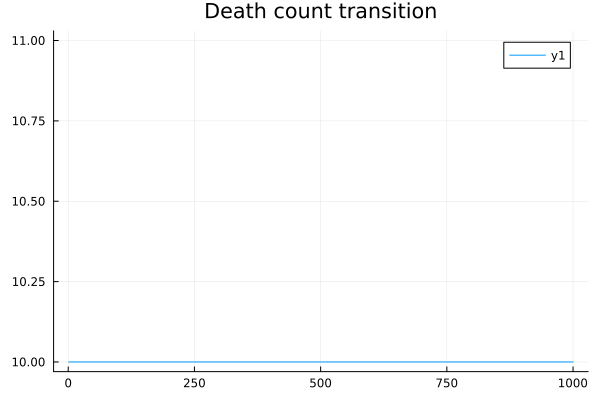

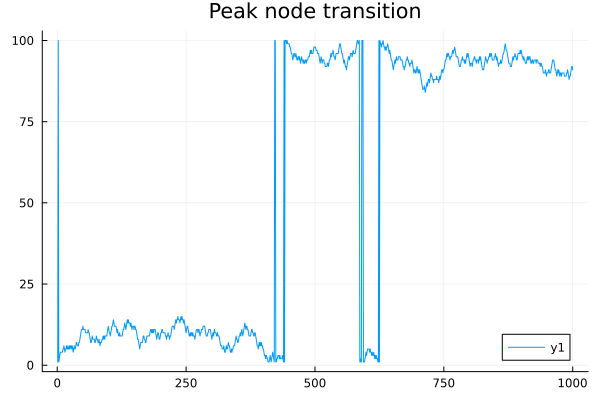

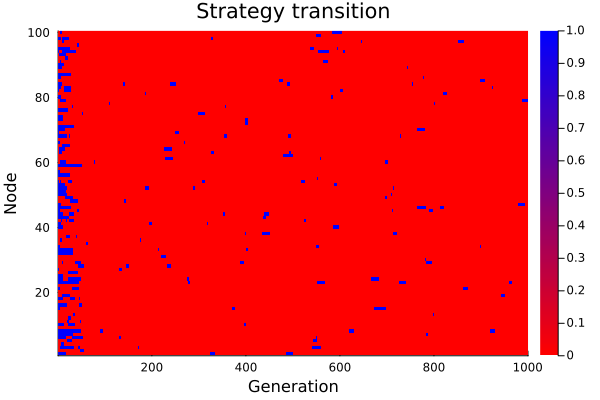

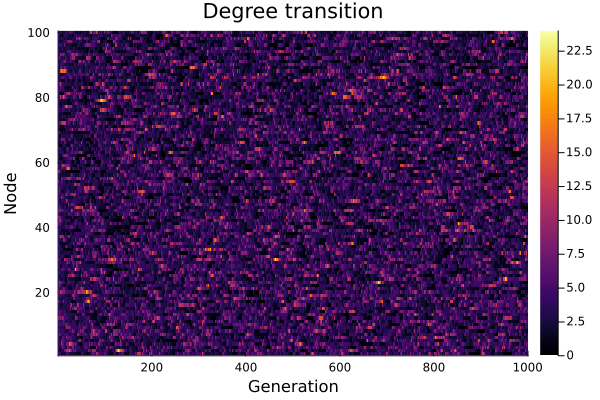

b: 1.75
C_rate: 0.011477045908183636
average_resource: 1.011326693928973
Average Degree (k̄):	 4.0
Average Distance (L):	 3.4926819212533498
Average Clustering Coefficient (C):	 0.02402745995423341


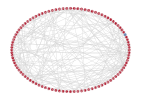

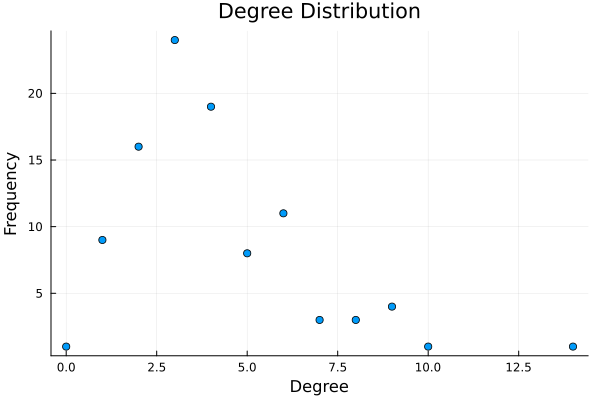

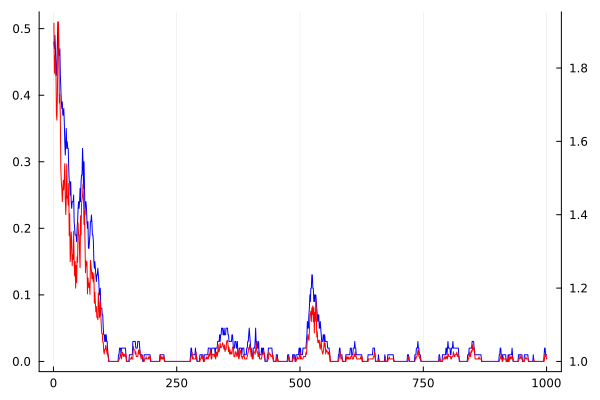

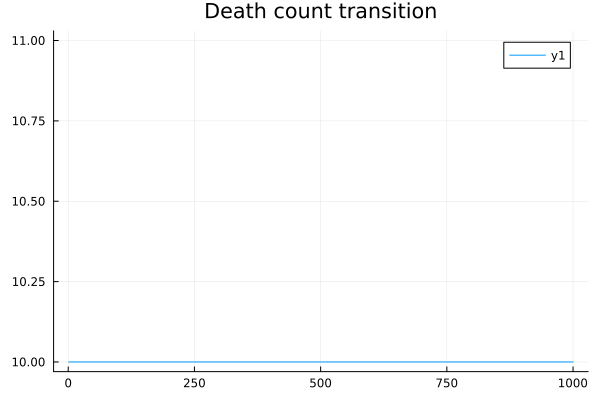

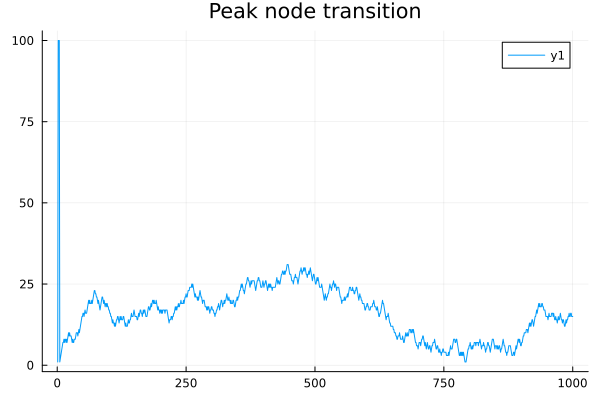

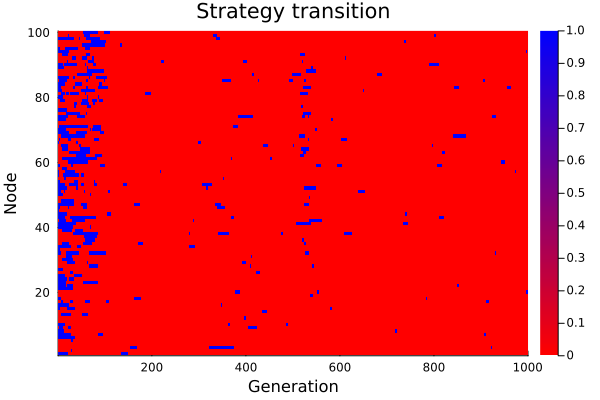

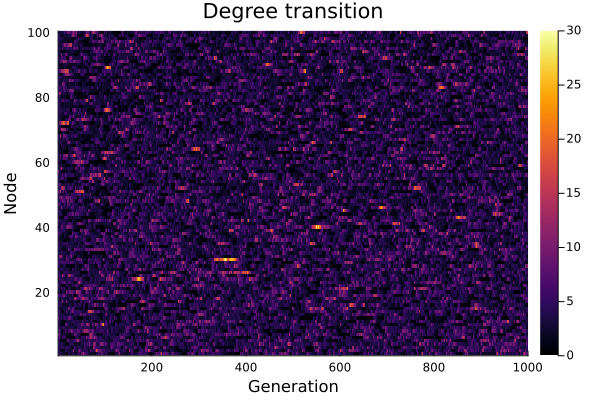

b: 1.9
C_rate: 0.04964071856287415
average_resource: 1.0730657970757203
Average Degree (k̄):	 4.0
Average Distance (L):	 3.3932017543859647
Average Clustering Coefficient (C):	 0.06774193548387097


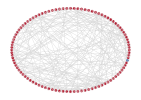

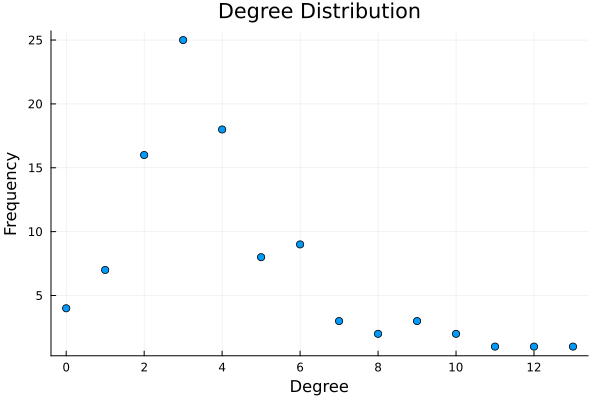

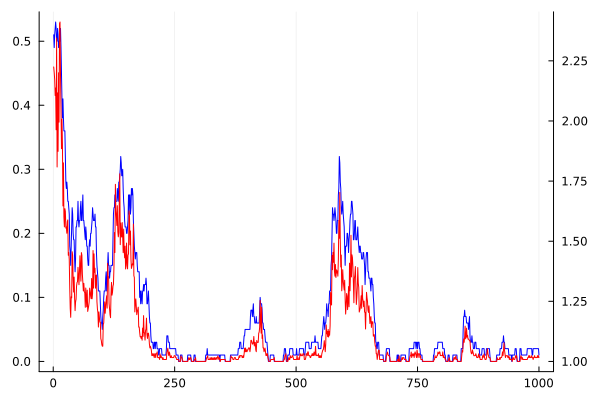

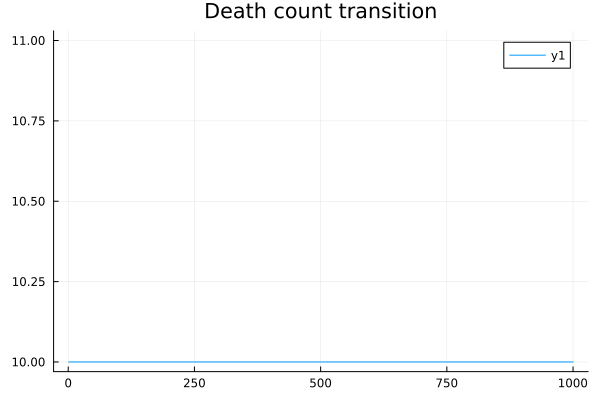

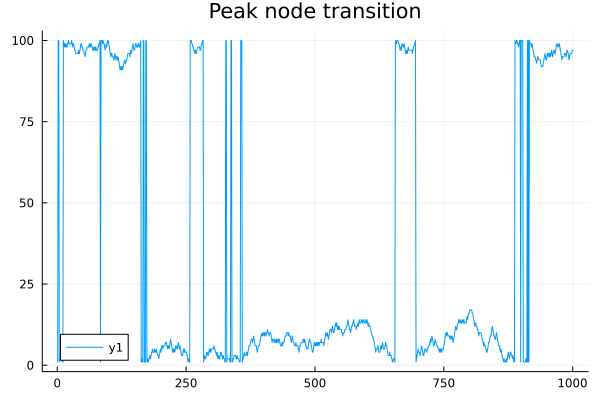

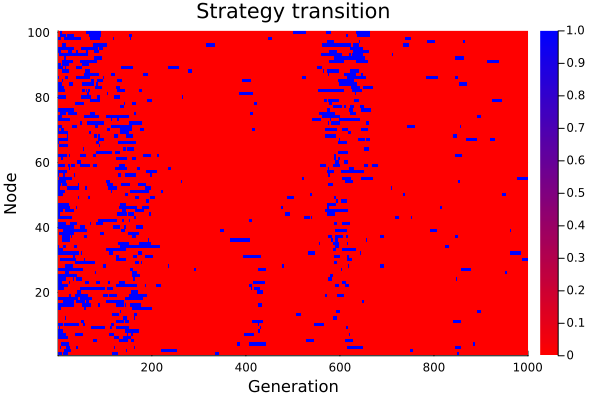

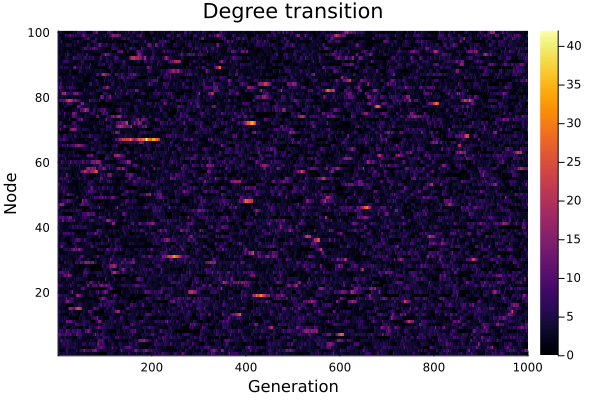

b: 1.95
C_rate: 0.9481636726546906
average_resource: 4.340682937952292
Average Degree (k̄):	 4.0
Average Distance (L):	 3.1287684038326713
Average Clustering Coefficient (C):	 0.05013192612137203


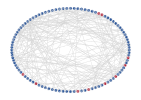

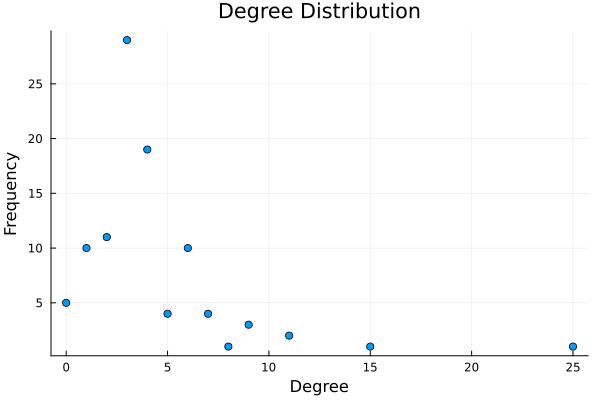

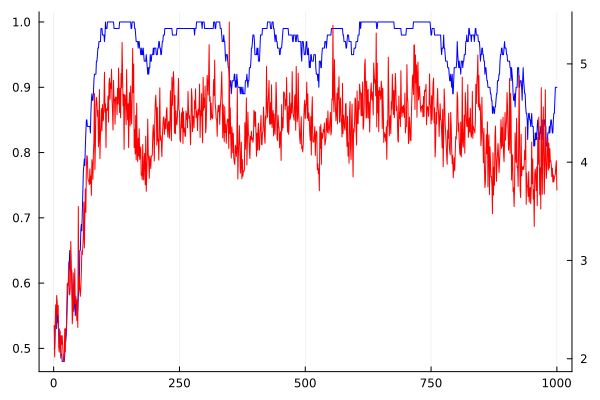

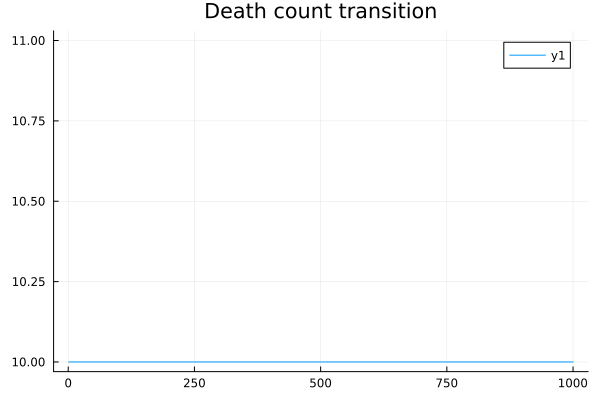

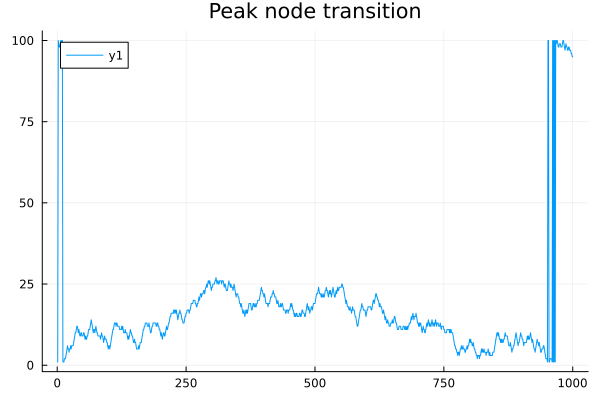

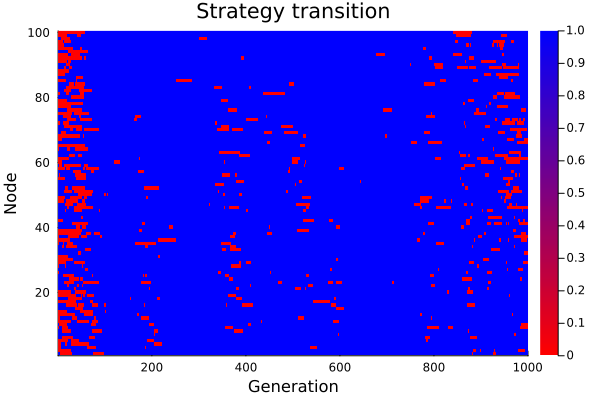

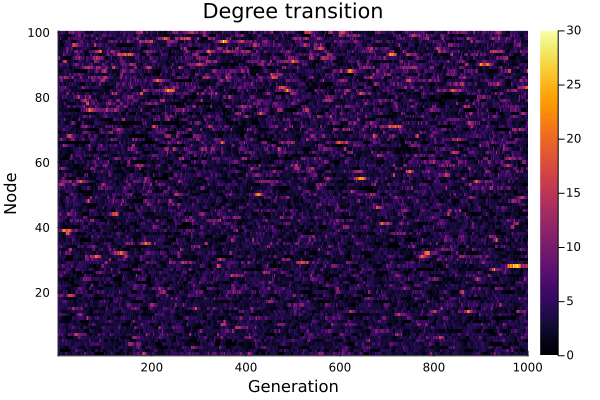

b: 2.0
C_rate: 0.9618562874251497
average_resource: 4.707047904191618
Average Degree (k̄):	 4.0
Average Distance (L):	 3.1567147105925417
Average Clustering Coefficient (C):	 0.05384615384615385


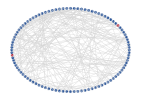

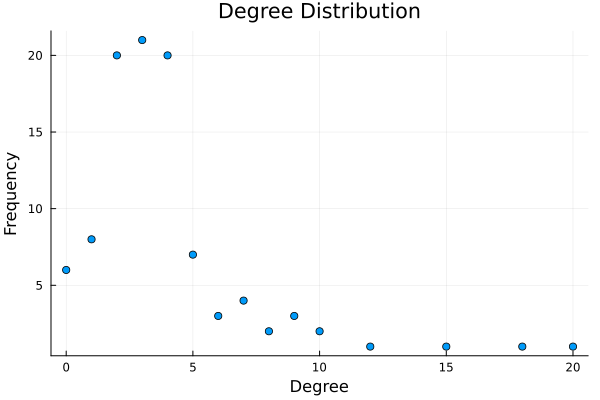

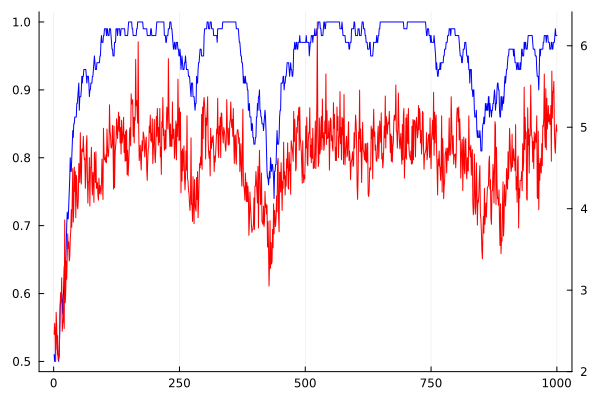

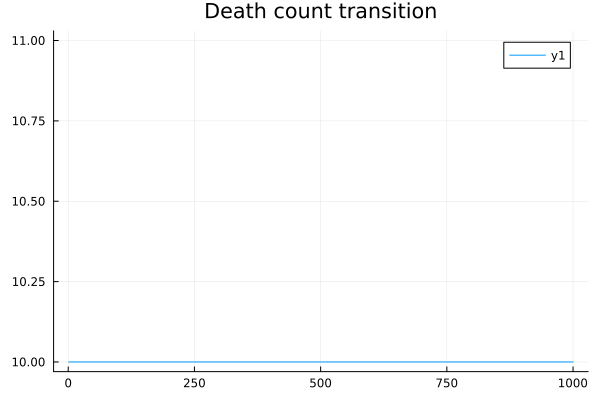

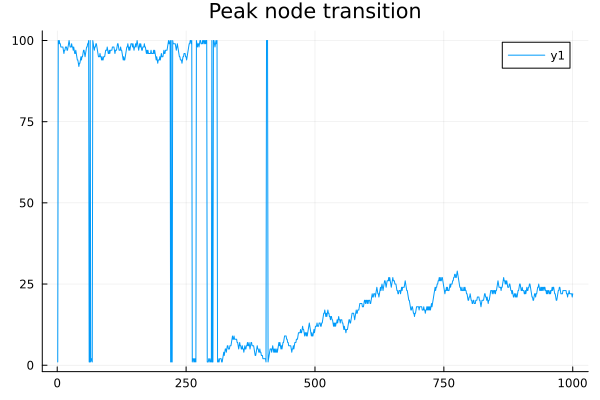

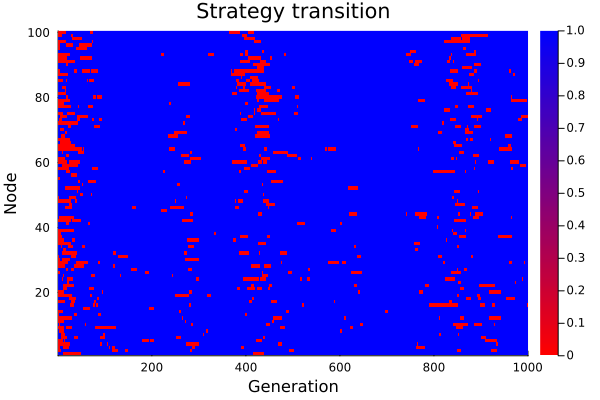

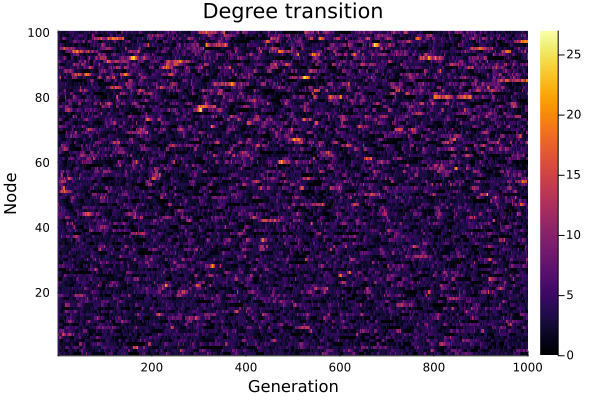

b: 2.05
C_rate: 0.9776846307385222
average_resource: 5.182701681638845
Average Degree (k̄):	 4.0
Average Distance (L):	 3.2285714285714286
Average Clustering Coefficient (C):	 0.042666666666666665


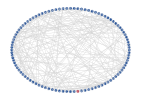

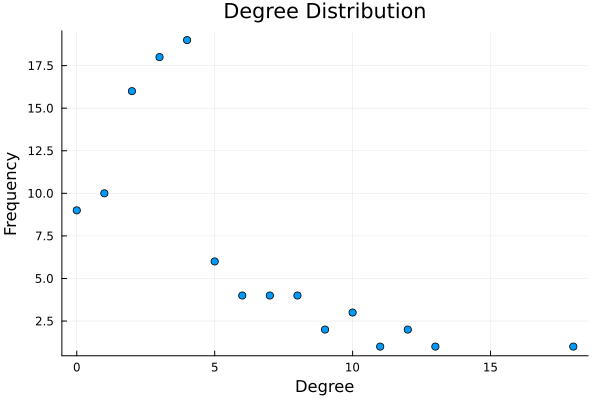

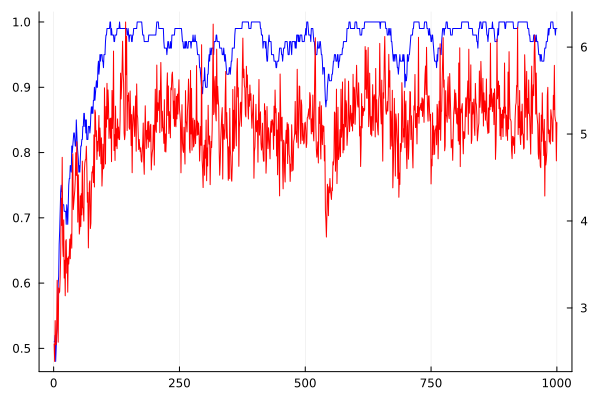

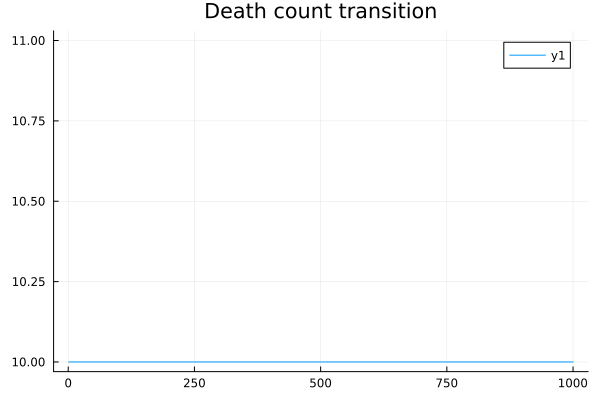

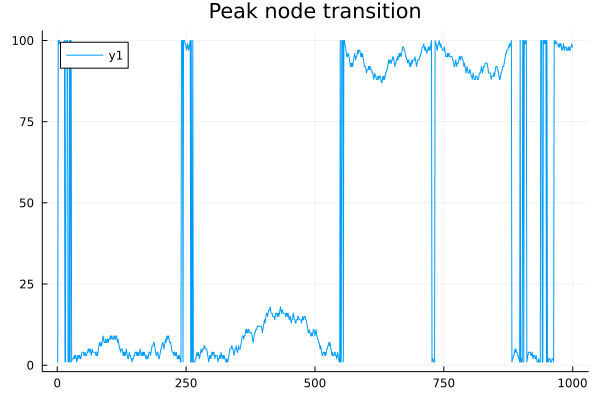

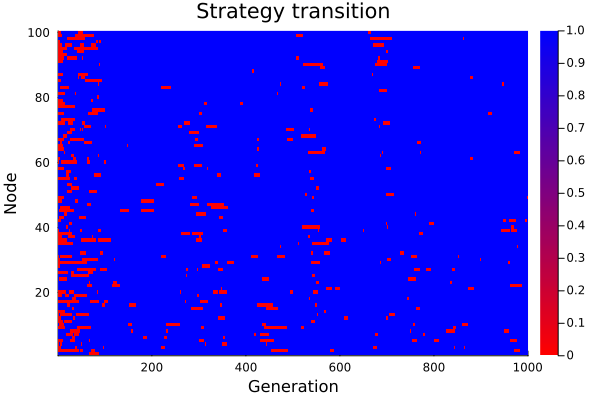

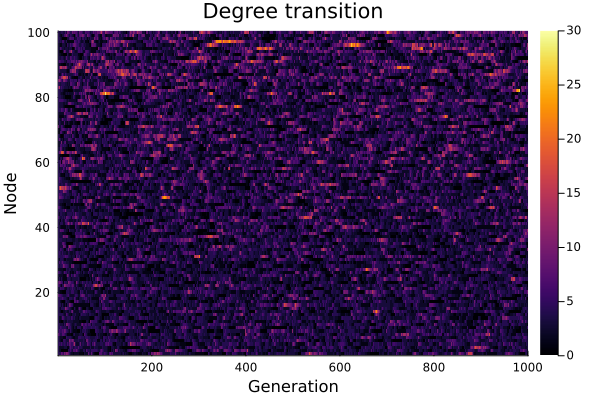

In [26]:
for b in b_vec
    p = Param(
        N = 100, k₀ = 4, generations = 1_000,
        b = b,
        C_rate₀ = C_rate₀,
        ev_hop = ev_hop,
        relationship_increment_factor = relationship_increment_factor,
        resource_decrement_factor = resource_decrement_factor,
        resource_limit = resource_limit,
        rng = MersenneTwister(random_seed)
    )
    m = Model(p)
    C_rate_vec, average_resource_vec, death_count_vec, rich_spot_vec, strategy_mat, degree_mat = run!(m, is_static)
    
    println("b: $(b)")
    println("C_rate: $(mean(C_rate_vec[round(Int, end * 0.5):end]))")
    println("average_resource: $(mean(average_resource_vec[round(Int, end * 0.5):end]))")
    g = SimpleGraph(m.relation_mat)
    desc(g)
    plot_graph(m.relation_mat, strategies_to_colors(m.strategy_vec))
    plot_degree_distribution(g)
    
    p = plot(C_rate_vec, label=false, color=:blue)
    plot!(twinx(), average_resource_vec, label=false, color=:red)
    display(p)
    
    plot(death_count_vec, title="Death count transition") |> display
    plot(rich_spot_vec, title="Peak node transition") |> display
    heatmap(transpose(strategy_mat .== C), color=[:red, :blue], xlabel="Generation", ylabel="Node", title="Strategy transition") |> display
    heatmap(transpose(degree_mat), xlabel="Generation", ylabel="Node", title="Degree transition") |> display
end